In [1]:
from torch.optim import Adam

import hyperparams as hp

from models import Encoder, Decoder, Seq2Seq
from sgdr import SGDRScheduler
from utils import train


from torchtext.legacy.data import Field, BucketIterator, TabularDataset



In [2]:
def tokenize(text):
        return [char for char in text]

batch_size = hp.batch_size
device = 'cuda'

ortho = Field(tokenize=tokenize, init_token='<sos>', eos_token='<eos>')
ipa = Field(tokenize=tokenize, init_token='<sos>', eos_token='<eos>')

fields = {'words':('src',ortho),'ipa':('trg',ipa)}

train_data, val_data = TabularDataset.splits(path='data',
                                              train='train.csv',
                                              test='val.csv',
                                              format='csv',
                                              fields=fields)

ortho.build_vocab(train_data.src)
ipa.build_vocab(train_data.trg)

train_iter, val_iter = BucketIterator.splits(
        (train_data, val_data), batch_size=batch_size, device=device, 
    repeat=False,
    sort_key = lambda x: len(x.src),
    sort_within_batch=True)

In [25]:
save(ortho,'vocab/ortho.pt')
save(ipa,'vocab/ipa.pt')

In [10]:
ortho = load('vocab/ortho.pt')
ipa = load('vocab/ipa.pt')

loss: 2.6218:   2%|▏         | 166/9665 [00:07<06:46, 23.39 batches/s]


loss: 1.5792:   3%|▎         | 331/9665 [00:14<07:17, 21.33 batches/s]


loss: 1.7458:   5%|▌         | 496/9665 [00:21<06:35, 23.18 batches/s]


loss: 1.2613:   7%|▋         | 661/9665 [00:28<06:34, 22.81 batches/s]


loss: 0.8969:   9%|▊         | 826/9665 [00:36<06:19, 23.29 batches/s]


loss: 1.1112:  10%|█         | 992/9665 [00:43<06:00, 24.06 batches/s]


loss: 0.7030:  12%|█▏        | 1154/9665 [00:50<06:20, 22.39 batches/s]


loss: 1.2082:  14%|█▎        | 1317/9665 [00:57<05:36, 24.82 batches/s]


loss: 0.6320:  15%|█▌        | 1482/9665 [01:04<06:14, 21.82 batches/s]


loss: 1.1450:  17%|█▋        | 1646/9665 [01:11<05:40, 23.56 batches/s]


loss: 0.7089:  19%|█▊        | 1808/9665 [01:18<06:04, 21.57 batches/s]


loss: 0.8036:  20%|██        | 1973/9665 [01:25<05:26, 23.55 batches/s]


loss: 0.8505:  22%|██▏       | 2136/9665 [01:32<05:19, 23.55 batches/s]


loss: 0.3734:  24%|██▍       | 2301/9665 [01:39<05:43, 21.42 batches/s]


loss: 0.8029:  25%|██▌       | 2463/9665 [01:46<05:12, 23.05 batches/s]


loss: 0.7135:  27%|██▋       | 2628/9665 [01:53<05:07, 22.92 batches/s]


loss: 0.2819:  29%|██▉       | 2791/9665 [02:00<04:34, 25.07 batches/s]


loss: 0.3699:  31%|███       | 2954/9665 [02:07<04:43, 23.68 batches/s]


loss: 0.8275:  32%|███▏      | 3119/9665 [02:14<04:29, 24.32 batches/s]


loss: 0.7567:  34%|███▍      | 3281/9665 [02:22<04:20, 24.54 batches/s]


loss: 0.4662:  36%|███▌      | 3445/9665 [02:29<04:14, 24.40 batches/s]


loss: 0.4163:  37%|███▋      | 3608/9665 [02:36<04:13, 23.91 batches/s]


loss: 0.4128:  39%|███▉      | 3774/9665 [02:43<04:17, 22.86 batches/s]


loss: 0.4208:  41%|████      | 3937/9665 [02:50<04:10, 22.84 batches/s]


loss: 0.4794:  42%|████▏     | 4100/9665 [02:57<04:08, 22.43 batches/s]


loss: 0.4275:  44%|████▍     | 4263/9665 [03:04<04:04, 22.13 batches/s]


loss: 0.7589:  46%|████▌     | 4427/9665 [03:11<03:48, 22.95 batches/s]


loss: 0.4261:  48%|████▊     | 4593/9665 [03:18<03:24, 24.83 batches/s]


loss: 0.5975:  49%|████▉     | 4755/9665 [03:25<03:29, 23.47 batches/s]


loss: 0.2614:  51%|█████     | 4920/9665 [03:32<03:33, 22.22 batches/s]


loss: 0.2455:  53%|█████▎    | 5082/9665 [03:39<03:09, 24.23 batches/s]


loss: 0.3631:  54%|█████▍    | 5247/9665 [03:46<03:05, 23.83 batches/s]


loss: 0.5550:  56%|█████▌    | 5410/9665 [03:53<02:57, 23.95 batches/s]


loss: 0.3849:  58%|█████▊    | 5573/9665 [04:00<02:35, 26.23 batches/s]


loss: 0.2242:  59%|█████▉    | 5738/9665 [04:07<02:58, 21.96 batches/s]


loss: 0.3400:  61%|██████    | 5900/9665 [04:14<02:43, 23.09 batches/s]


loss: 0.3062:  63%|██████▎   | 6066/9665 [04:21<02:44, 21.86 batches/s]


loss: 0.2155:  64%|██████▍   | 6229/9665 [04:28<02:31, 22.73 batches/s]


loss: 1.1301:  66%|██████▌   | 6391/9665 [04:35<02:13, 24.60 batches/s]


loss: 0.3609:  68%|██████▊   | 6557/9665 [04:42<01:59, 26.07 batches/s]


loss: 0.1939:  70%|██████▉   | 6720/9665 [04:49<01:52, 26.08 batches/s]


loss: 0.4482:  71%|███████   | 6882/9665 [04:56<01:54, 24.26 batches/s]


loss: 0.5130:  73%|███████▎  | 7048/9665 [05:03<01:53, 23.00 batches/s]


loss: 0.2651:  75%|███████▍  | 7211/9665 [05:10<01:49, 22.48 batches/s]


loss: 0.3216:  76%|███████▋  | 7376/9665 [05:17<01:39, 23.04 batches/s]


loss: 0.3563:  78%|███████▊  | 7538/9665 [05:24<01:32, 22.95 batches/s]


loss: 0.3200:  80%|███████▉  | 7701/9665 [05:31<01:23, 23.59 batches/s]


loss: 1.0612:  81%|████████▏ | 7867/9665 [05:38<01:18, 22.98 batches/s]


loss: 0.4202:  83%|████████▎ | 8029/9665 [05:45<01:07, 24.10 batches/s]


loss: 0.6379:  85%|████████▍ | 8191/9665 [05:52<01:01, 23.93 batches/s]


loss: 0.2132:  86%|████████▋ | 8356/9665 [05:59<01:02, 20.87 batches/s]


loss: 0.3159:  88%|████████▊ | 8522/9665 [06:06<00:46, 24.33 batches/s]


loss: 0.3677:  90%|████████▉ | 8684/9665 [06:13<00:39, 24.58 batches/s]


loss: 0.2129:  92%|█████████▏| 8849/9665 [06:20<00:32, 25.28 batches/s]


loss: 0.3784:  93%|█████████▎| 9013/9665 [06:27<00:29, 22.08 batches/s]


loss: 0.4347:  95%|█████████▍| 9177/9665 [06:34<00:21, 22.54 batches/s]


loss: 0.6522:  97%|█████████▋| 9339/9665 [06:41<00:13, 23.60 batches/s]


loss: 0.4114:  98%|█████████▊| 9504/9665 [06:48<00:07, 22.15 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.6384:   2%|▏         | 165/9665 [00:07<07:00, 22.59 batches/s]


loss: 0.4603:   3%|▎         | 333/9665 [00:14<06:53, 22.54 batches/s]


loss: 0.2655:   5%|▌         | 495/9665 [00:21<06:32, 23.38 batches/s]


loss: 0.3363:   7%|▋         | 663/9665 [00:28<06:37, 22.64 batches/s]


loss: 0.1976:   9%|▊         | 829/9665 [00:35<05:38, 26.07 batches/s]


loss: 0.5080:  10%|█         | 992/9665 [00:42<05:46, 25.02 batches/s]


loss: 0.4274:  12%|█▏        | 1157/9665 [00:49<05:49, 24.35 batches/s]


loss: 0.1547:  14%|█▎        | 1319/9665 [00:56<05:57, 23.35 batches/s]


loss: 0.2179:  15%|█▌        | 1483/9665 [01:03<05:22, 25.40 batches/s]


loss: 0.1764:  17%|█▋        | 1648/9665 [01:10<05:31, 24.16 batches/s]


loss: 0.4348:  19%|█▊        | 1811/9665 [01:17<05:49, 22.49 batches/s]


loss: 0.1632:  20%|██        | 1974/9665 [01:24<05:17, 24.22 batches/s]


loss: 0.5641:  22%|██▏       | 2140/9665 [01:31<05:36, 22.35 batches/s]


loss: 0.7544:  24%|██▍       | 2302/9665 [01:38<05:37, 21.84 batches/s]


loss: 0.1989:  26%|██▌       | 2467/9665 [01:46<05:40, 21.15 batches/s]


loss: 0.3194:  27%|██▋       | 2629/9665 [01:53<05:06, 22.98 batches/s]


loss: 0.4399:  29%|██▉       | 2793/9665 [02:00<04:56, 23.20 batches/s]


loss: 0.4358:  31%|███       | 2956/9665 [02:07<04:34, 24.42 batches/s]


loss: 0.3281:  32%|███▏      | 3120/9665 [02:14<04:51, 22.43 batches/s]


loss: 0.4201:  34%|███▍      | 3285/9665 [02:21<04:44, 22.45 batches/s]


loss: 0.3758:  36%|███▌      | 3450/9665 [02:28<04:23, 23.55 batches/s]


loss: 0.2787:  37%|███▋      | 3612/9665 [02:35<04:43, 21.33 batches/s]


loss: 0.4374:  39%|███▉      | 3775/9665 [02:42<04:02, 24.28 batches/s]


loss: 0.1508:  41%|████      | 3940/9665 [02:49<04:14, 22.53 batches/s]


loss: 0.4963:  42%|████▏     | 4103/9665 [02:56<03:52, 23.97 batches/s]


loss: 0.4219:  44%|████▍     | 4268/9665 [03:03<03:53, 23.15 batches/s]


loss: 0.3459:  46%|████▌     | 4431/9665 [03:10<03:58, 21.97 batches/s]


loss: 0.2929:  48%|████▊     | 4594/9665 [03:17<03:46, 22.43 batches/s]


loss: 0.3124:  49%|████▉     | 4759/9665 [03:24<03:18, 24.67 batches/s]


loss: 0.1189:  51%|█████     | 4921/9665 [03:31<03:22, 23.44 batches/s]


loss: 0.1468:  53%|█████▎    | 5086/9665 [03:38<03:26, 22.22 batches/s]


loss: 0.2641:  54%|█████▍    | 5249/9665 [03:45<03:03, 24.00 batches/s]


loss: 0.3857:  56%|█████▌    | 5412/9665 [03:52<03:11, 22.20 batches/s]


loss: 0.1751:  58%|█████▊    | 5577/9665 [03:59<02:57, 23.08 batches/s]


loss: 0.3882:  59%|█████▉    | 5740/9665 [04:06<02:55, 22.32 batches/s]


loss: 0.1587:  61%|██████    | 5902/9665 [04:13<02:49, 22.16 batches/s]


loss: 0.2499:  63%|██████▎   | 6067/9665 [04:20<02:34, 23.25 batches/s]


loss: 0.3768:  64%|██████▍   | 6231/9665 [04:27<02:26, 23.43 batches/s]


loss: 0.1631:  66%|██████▌   | 6394/9665 [04:34<02:17, 23.85 batches/s]


loss: 0.4560:  68%|██████▊   | 6557/9665 [04:41<02:14, 23.03 batches/s]


loss: 0.2769:  70%|██████▉   | 6722/9665 [04:48<02:04, 23.56 batches/s]


loss: 0.1724:  71%|███████   | 6884/9665 [04:55<01:52, 24.63 batches/s]


loss: 0.3624:  73%|███████▎  | 7049/9665 [05:02<01:58, 22.04 batches/s]


loss: 0.2900:  75%|███████▍  | 7212/9665 [05:09<01:34, 25.99 batches/s]


loss: 0.3573:  76%|███████▋  | 7377/9665 [05:16<01:35, 24.02 batches/s]


loss: 0.2547:  78%|███████▊  | 7541/9665 [05:23<01:36, 21.97 batches/s]


loss: 0.1028:  80%|███████▉  | 7703/9665 [05:30<01:22, 23.91 batches/s]


loss: 0.1633:  81%|████████▏ | 7868/9665 [05:37<01:22, 21.80 batches/s]


loss: 0.2348:  83%|████████▎ | 8031/9665 [05:44<01:06, 24.67 batches/s]


loss: 0.7136:  85%|████████▍ | 8195/9665 [05:51<01:07, 21.82 batches/s]


loss: 0.1776:  86%|████████▋ | 8358/9665 [05:58<00:52, 24.98 batches/s]


loss: 0.2499:  88%|████████▊ | 8521/9665 [06:05<00:49, 23.17 batches/s]


loss: 0.3479:  90%|████████▉ | 8686/9665 [06:12<00:38, 25.35 batches/s]


loss: 0.1998:  92%|█████████▏| 8851/9665 [06:19<00:33, 24.56 batches/s]


loss: 0.5968:  93%|█████████▎| 9013/9665 [06:26<00:27, 24.12 batches/s]


loss: 0.3626:  95%|█████████▍| 9178/9665 [06:33<00:22, 21.99 batches/s]


loss: 0.2332:  97%|█████████▋| 9340/9665 [06:41<00:14, 22.72 batches/s]


loss: 0.2884:  98%|█████████▊| 9503/9665 [06:48<00:06, 23.32 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.2261:   2%|▏         | 165/9665 [00:07<06:29, 24.37 batches/s]


loss: 0.1597:   3%|▎         | 330/9665 [00:14<06:36, 23.53 batches/s]


loss: 0.0924:   5%|▌         | 495/9665 [00:21<06:49, 22.38 batches/s]


loss: 0.2324:   7%|▋         | 661/9665 [00:28<06:23, 23.47 batches/s]


loss: 0.1299:   9%|▊         | 826/9665 [00:36<06:15, 23.53 batches/s]


loss: 0.0745:  10%|█         | 991/9665 [00:43<05:43, 25.22 batches/s]


loss: 0.1362:  12%|█▏        | 1155/9665 [00:50<06:06, 23.23 batches/s]


loss: 0.2788:  14%|█▎        | 1318/9665 [00:57<05:57, 23.34 batches/s]


loss: 0.4000:  15%|█▌        | 1484/9665 [01:04<06:00, 22.69 batches/s]


loss: 0.3450:  17%|█▋        | 1647/9665 [01:11<05:28, 24.43 batches/s]


loss: 0.3148:  19%|█▊        | 1810/9665 [01:18<06:00, 21.77 batches/s]


loss: 0.3980:  20%|██        | 1973/9665 [01:25<05:33, 23.07 batches/s]


loss: 0.2430:  22%|██▏       | 2138/9665 [01:32<05:11, 24.16 batches/s]


loss: 0.3026:  24%|██▍       | 2302/9665 [01:39<05:13, 23.51 batches/s]


loss: 0.1623:  26%|██▌       | 2465/9665 [01:46<04:53, 24.49 batches/s]


loss: 0.2395:  27%|██▋       | 2631/9665 [01:53<05:11, 22.59 batches/s]


loss: 0.3349:  29%|██▉       | 2795/9665 [02:00<04:48, 23.84 batches/s]


loss: 0.0840:  31%|███       | 2958/9665 [02:07<04:20, 25.79 batches/s]


loss: 0.2824:  32%|███▏      | 3123/9665 [02:14<04:51, 22.43 batches/s]


loss: 0.1825:  34%|███▍      | 3287/9665 [02:21<04:30, 23.60 batches/s]


loss: 0.1813:  36%|███▌      | 3450/9665 [02:28<04:31, 22.89 batches/s]


loss: 0.3896:  37%|███▋      | 3615/9665 [02:34<04:07, 24.46 batches/s]


loss: 0.1627:  39%|███▉      | 3778/9665 [02:41<04:01, 24.39 batches/s]


loss: 0.2139:  41%|████      | 3942/9665 [02:48<03:51, 24.67 batches/s]


loss: 0.5625:  42%|████▏     | 4105/9665 [02:55<03:40, 25.24 batches/s]


loss: 0.2262:  44%|████▍     | 4269/9665 [03:02<03:34, 25.16 batches/s]


loss: 0.2290:  46%|████▌     | 4433/9665 [03:09<03:45, 23.18 batches/s]


loss: 0.2340:  48%|████▊     | 4597/9665 [03:16<03:33, 23.74 batches/s]


loss: 0.1370:  49%|████▉     | 4761/9665 [03:23<03:07, 26.22 batches/s]


loss: 0.2432:  51%|█████     | 4925/9665 [03:30<03:32, 22.28 batches/s]


loss: 0.1168:  53%|█████▎    | 5090/9665 [03:36<03:14, 23.51 batches/s]


loss: 0.3031:  54%|█████▍    | 5255/9665 [03:43<03:03, 24.03 batches/s]


loss: 0.2222:  56%|█████▌    | 5417/9665 [03:50<02:59, 23.72 batches/s]


loss: 0.1681:  58%|█████▊    | 5580/9665 [03:57<02:46, 24.52 batches/s]


loss: 0.2659:  59%|█████▉    | 5744/9665 [04:04<02:41, 24.32 batches/s]


loss: 0.6348:  61%|██████    | 5910/9665 [04:11<02:47, 22.41 batches/s]


loss: 0.1779:  63%|██████▎   | 6073/9665 [04:18<02:48, 21.29 batches/s]


loss: 0.0673:  65%|██████▍   | 6235/9665 [04:25<02:34, 22.24 batches/s]


loss: 0.5491:  66%|██████▌   | 6399/9665 [04:32<02:24, 22.63 batches/s]


loss: 0.5929:  68%|██████▊   | 6563/9665 [04:39<02:09, 23.96 batches/s]


loss: 0.1981:  70%|██████▉   | 6727/9665 [04:46<02:04, 23.62 batches/s]


loss: 0.0813:  71%|███████▏  | 6893/9665 [04:53<01:55, 23.93 batches/s]


loss: 0.2332:  73%|███████▎  | 7055/9665 [05:00<01:43, 25.23 batches/s]


loss: 0.1245:  75%|███████▍  | 7220/9665 [05:07<01:42, 23.84 batches/s]


loss: 0.0912:  76%|███████▋  | 7382/9665 [05:14<01:34, 24.19 batches/s]


loss: 0.1694:  78%|███████▊  | 7548/9665 [05:21<01:27, 24.15 batches/s]


loss: 0.1399:  80%|███████▉  | 7711/9665 [05:28<01:25, 22.78 batches/s]


loss: 0.2772:  81%|████████▏ | 7876/9665 [05:35<01:12, 24.63 batches/s]


loss: 0.1565:  83%|████████▎ | 8039/9665 [05:42<01:13, 22.22 batches/s]


loss: 0.3614:  85%|████████▍ | 8203/9665 [05:49<01:04, 22.61 batches/s]


loss: 0.3989:  87%|████████▋ | 8365/9665 [05:56<00:54, 24.03 batches/s]


loss: 0.0750:  88%|████████▊ | 8530/9665 [06:03<00:50, 22.66 batches/s]


loss: 0.1908:  90%|████████▉ | 8692/9665 [06:10<00:42, 22.87 batches/s]


loss: 0.3052:  92%|█████████▏| 8856/9665 [06:17<00:35, 22.90 batches/s]


loss: 0.0856:  93%|█████████▎| 9022/9665 [06:25<00:28, 22.28 batches/s]


loss: 0.1576:  95%|█████████▌| 9185/9665 [06:32<00:19, 24.07 batches/s]


loss: 0.3390:  97%|█████████▋| 9347/9665 [06:39<00:13, 23.87 batches/s]


loss: 0.2011:  98%|█████████▊| 9512/9665 [06:46<00:06, 23.30 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0875:   2%|▏         | 165/9665 [00:07<07:23, 21.40 batches/s]


loss: 0.3260:   3%|▎         | 332/9665 [00:14<06:29, 23.96 batches/s]


loss: 0.2060:   5%|▌         | 498/9665 [00:21<06:17, 24.28 batches/s]


loss: 0.3778:   7%|▋         | 661/9665 [00:28<06:00, 24.96 batches/s]


loss: 0.1522:   9%|▊         | 827/9665 [00:35<06:03, 24.32 batches/s]


loss: 0.1761:  10%|█         | 994/9665 [00:42<06:22, 22.64 batches/s]


loss: 0.0938:  12%|█▏        | 1156/9665 [00:49<06:09, 23.04 batches/s]


loss: 0.1816:  14%|█▎        | 1319/9665 [00:57<06:17, 22.08 batches/s]


loss: 0.4428:  15%|█▌        | 1484/9665 [01:04<06:18, 21.59 batches/s]


loss: 0.1738:  17%|█▋        | 1649/9665 [01:11<05:08, 25.96 batches/s]


loss: 0.1754:  19%|█▊        | 1812/9665 [01:18<05:22, 24.37 batches/s]


loss: 0.3753:  20%|██        | 1975/9665 [01:25<05:40, 22.56 batches/s]


loss: 0.3220:  22%|██▏       | 2138/9665 [01:32<05:07, 24.52 batches/s]


loss: 0.0514:  24%|██▍       | 2304/9665 [01:39<05:20, 22.94 batches/s]


loss: 0.1559:  26%|██▌       | 2467/9665 [01:46<05:01, 23.90 batches/s]


loss: 0.0829:  27%|██▋       | 2629/9665 [01:53<04:57, 23.67 batches/s]


loss: 0.1349:  29%|██▉       | 2794/9665 [02:00<04:55, 23.28 batches/s]


loss: 0.1443:  31%|███       | 2956/9665 [02:07<04:34, 24.48 batches/s]


loss: 0.1580:  32%|███▏      | 3121/9665 [02:14<04:38, 23.53 batches/s]


loss: 0.0738:  34%|███▍      | 3283/9665 [02:21<04:28, 23.77 batches/s]


loss: 0.3442:  36%|███▌      | 3448/9665 [02:28<04:22, 23.64 batches/s]


loss: 0.1918:  37%|███▋      | 3612/9665 [02:35<04:32, 22.18 batches/s]


loss: 0.2438:  39%|███▉      | 3775/9665 [02:42<04:17, 22.91 batches/s]


loss: 0.1479:  41%|████      | 3939/9665 [02:50<04:34, 20.89 batches/s]


loss: 0.3086:  42%|████▏     | 4105/9665 [02:57<03:53, 23.77 batches/s]


loss: 0.1273:  44%|████▍     | 4267/9665 [03:04<03:52, 23.17 batches/s]


loss: 0.2946:  46%|████▌     | 4430/9665 [03:11<03:53, 22.42 batches/s]


loss: 0.2652:  48%|████▊     | 4595/9665 [03:18<03:36, 23.44 batches/s]


loss: 0.1388:  49%|████▉     | 4757/9665 [03:25<03:24, 23.98 batches/s]


loss: 0.0815:  51%|█████     | 4922/9665 [03:32<03:29, 22.64 batches/s]


loss: 0.2417:  53%|█████▎    | 5085/9665 [03:39<03:35, 21.25 batches/s]


loss: 0.1044:  54%|█████▍    | 5248/9665 [03:46<02:53, 25.49 batches/s]


loss: 0.1485:  56%|█████▌    | 5413/9665 [03:53<02:54, 24.37 batches/s]


loss: 0.1503:  58%|█████▊    | 5576/9665 [04:00<03:05, 22.04 batches/s]


loss: 0.1593:  59%|█████▉    | 5741/9665 [04:07<02:38, 24.79 batches/s]


loss: 0.1449:  61%|██████    | 5903/9665 [04:15<02:42, 23.14 batches/s]


loss: 0.1883:  63%|██████▎   | 6066/9665 [04:22<02:38, 22.66 batches/s]


loss: 0.0677:  64%|██████▍   | 6231/9665 [04:29<02:37, 21.86 batches/s]


loss: 0.0895:  66%|██████▌   | 6393/9665 [04:36<02:10, 25.14 batches/s]


loss: 0.1417:  68%|██████▊   | 6559/9665 [04:43<02:20, 22.06 batches/s]


loss: 0.2055:  70%|██████▉   | 6721/9665 [04:50<02:18, 21.18 batches/s]


loss: 0.1498:  71%|███████▏  | 6887/9665 [04:57<02:03, 22.44 batches/s]


loss: 0.1190:  73%|███████▎  | 7049/9665 [05:04<01:48, 24.12 batches/s]


loss: 0.0949:  75%|███████▍  | 7212/9665 [05:11<01:46, 22.96 batches/s]


loss: 0.1722:  76%|███████▋  | 7377/9665 [05:18<01:45, 21.69 batches/s]


loss: 0.0708:  78%|███████▊  | 7541/9665 [05:25<01:31, 23.23 batches/s]


loss: 0.0642:  80%|███████▉  | 7704/9665 [05:32<01:19, 24.60 batches/s]


loss: 0.1421:  81%|████████▏ | 7867/9665 [05:39<01:18, 22.88 batches/s]


loss: 0.0850:  83%|████████▎ | 8033/9665 [05:46<01:12, 22.54 batches/s]


loss: 0.2640:  85%|████████▍ | 8196/9665 [05:54<01:04, 22.89 batches/s]


loss: 0.1825:  86%|████████▋ | 8358/9665 [06:01<00:56, 23.31 batches/s]


loss: 0.2060:  88%|████████▊ | 8524/9665 [06:08<00:48, 23.48 batches/s]


loss: 0.2003:  90%|████████▉ | 8687/9665 [06:15<00:46, 21.26 batches/s]


loss: 0.1814:  92%|█████████▏| 8850/9665 [06:22<00:35, 23.21 batches/s]


loss: 0.0880:  93%|█████████▎| 9014/9665 [06:29<00:27, 24.08 batches/s]


loss: 0.2735:  95%|█████████▍| 9177/9665 [06:36<00:20, 23.78 batches/s]


loss: 0.1099:  97%|█████████▋| 9342/9665 [06:43<00:13, 23.60 batches/s]


loss: 0.0572:  98%|█████████▊| 9505/9665 [06:50<00:06, 25.42 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.1238:   2%|▏         | 166/9665 [00:07<06:16, 25.21 batches/s]


loss: 0.2083:   3%|▎         | 333/9665 [00:14<06:37, 23.46 batches/s]


loss: 0.1147:   5%|▌         | 496/9665 [00:21<06:47, 22.49 batches/s]


loss: 0.0499:   7%|▋         | 661/9665 [00:28<06:12, 24.18 batches/s]


loss: 0.2114:   9%|▊         | 827/9665 [00:35<06:15, 23.54 batches/s]


loss: 0.1083:  10%|█         | 992/9665 [00:43<06:33, 22.03 batches/s]


loss: 0.1124:  12%|█▏        | 1155/9665 [00:49<06:25, 22.05 batches/s]


loss: 0.0592:  14%|█▎        | 1319/9665 [00:57<06:17, 22.09 batches/s]


loss: 0.1676:  15%|█▌        | 1484/9665 [01:04<05:27, 24.96 batches/s]


loss: 0.1459:  17%|█▋        | 1649/9665 [01:11<05:39, 23.64 batches/s]


loss: 0.1336:  19%|█▉        | 1813/9665 [01:18<05:29, 23.82 batches/s]


loss: 0.1087:  20%|██        | 1975/9665 [01:25<05:22, 23.86 batches/s]


loss: 0.1972:  22%|██▏       | 2140/9665 [01:32<05:10, 24.21 batches/s]


loss: 0.0949:  24%|██▍       | 2302/9665 [01:39<05:11, 23.66 batches/s]


loss: 0.1579:  26%|██▌       | 2468/9665 [01:46<04:53, 24.50 batches/s]


loss: 0.0680:  27%|██▋       | 2631/9665 [01:53<05:17, 22.12 batches/s]


loss: 0.1473:  29%|██▉       | 2795/9665 [02:00<04:46, 23.99 batches/s]


loss: 0.1782:  31%|███       | 2958/9665 [02:07<04:34, 24.43 batches/s]


loss: 0.0984:  32%|███▏      | 3123/9665 [02:14<04:52, 22.35 batches/s]


loss: 0.0582:  34%|███▍      | 3286/9665 [02:21<04:52, 21.77 batches/s]


loss: 0.1171:  36%|███▌      | 3448/9665 [02:29<04:32, 22.78 batches/s]


loss: 0.1736:  37%|███▋      | 3614/9665 [02:36<04:28, 22.51 batches/s]


loss: 0.0967:  39%|███▉      | 3777/9665 [02:43<04:28, 21.90 batches/s]


loss: 0.0601:  41%|████      | 3941/9665 [02:50<03:39, 26.06 batches/s]


loss: 0.4739:  42%|████▏     | 4103/9665 [02:57<04:04, 22.76 batches/s]


loss: 0.3525:  44%|████▍     | 4268/9665 [03:04<03:46, 23.86 batches/s]


loss: 0.1967:  46%|████▌     | 4431/9665 [03:11<03:45, 23.25 batches/s]


loss: 0.2025:  48%|████▊     | 4595/9665 [03:18<03:25, 24.66 batches/s]


loss: 0.1418:  49%|████▉     | 4760/9665 [03:25<03:41, 22.11 batches/s]


loss: 0.1048:  51%|█████     | 4922/9665 [03:32<03:43, 21.20 batches/s]


loss: 0.0822:  53%|█████▎    | 5087/9665 [03:39<03:24, 22.34 batches/s]


loss: 0.0970:  54%|█████▍    | 5249/9665 [03:46<03:05, 23.79 batches/s]


loss: 0.2020:  56%|█████▌    | 5414/9665 [03:53<03:05, 22.86 batches/s]


loss: 0.1684:  58%|█████▊    | 5577/9665 [04:00<03:11, 21.37 batches/s]


loss: 0.1386:  59%|█████▉    | 5740/9665 [04:07<02:33, 25.57 batches/s]


loss: 0.0675:  61%|██████    | 5903/9665 [04:15<02:52, 21.84 batches/s]


loss: 0.1552:  63%|██████▎   | 6068/9665 [04:22<02:37, 22.77 batches/s]


loss: 0.2627:  64%|██████▍   | 6231/9665 [04:29<02:27, 23.20 batches/s]


loss: 0.1087:  66%|██████▌   | 6396/9665 [04:36<02:32, 21.49 batches/s]


loss: 0.1541:  68%|██████▊   | 6558/9665 [04:43<02:11, 23.65 batches/s]


loss: 0.5852:  70%|██████▉   | 6723/9665 [04:50<02:01, 24.20 batches/s]


loss: 0.0872:  71%|███████   | 6885/9665 [04:57<02:07, 21.76 batches/s]


loss: 0.2326:  73%|███████▎  | 7050/9665 [05:04<01:48, 24.03 batches/s]


loss: 0.2708:  75%|███████▍  | 7212/9665 [05:11<01:55, 21.16 batches/s]


loss: 0.3123:  76%|███████▋  | 7377/9665 [05:19<01:38, 23.16 batches/s]


loss: 0.3507:  78%|███████▊  | 7540/9665 [05:26<01:28, 23.93 batches/s]


loss: 0.1905:  80%|███████▉  | 7703/9665 [05:33<01:24, 23.34 batches/s]


loss: 0.1226:  81%|████████▏ | 7868/9665 [05:40<01:16, 23.51 batches/s]


loss: 0.1928:  83%|████████▎ | 8031/9665 [05:47<01:13, 22.30 batches/s]


loss: 0.0651:  85%|████████▍ | 8193/9665 [05:54<01:04, 22.90 batches/s]


loss: 0.1864:  86%|████████▋ | 8359/9665 [06:01<00:56, 23.08 batches/s]


loss: 0.0975:  88%|████████▊ | 8522/9665 [06:08<00:48, 23.53 batches/s]


loss: 0.1633:  90%|████████▉ | 8684/9665 [06:15<00:40, 23.95 batches/s]


loss: 0.0568:  92%|█████████▏| 8850/9665 [06:22<00:35, 23.06 batches/s]


loss: 0.2017:  93%|█████████▎| 9013/9665 [06:29<00:27, 24.00 batches/s]


loss: 0.1022:  95%|█████████▍| 9175/9665 [06:36<00:21, 22.40 batches/s]


loss: 0.1897:  97%|█████████▋| 9340/9665 [06:44<00:13, 23.63 batches/s]


loss: 0.2529:  98%|█████████▊| 9503/9665 [06:51<00:07, 22.61 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.1084:   2%|▏         | 166/9665 [00:07<07:15, 21.79 batches/s]


loss: 0.1045:   3%|▎         | 332/9665 [00:14<06:32, 23.77 batches/s]


loss: 0.3549:   5%|▌         | 495/9665 [00:21<05:54, 25.84 batches/s]


loss: 0.1105:   7%|▋         | 660/9665 [00:28<06:20, 23.66 batches/s]


loss: 0.1745:   9%|▊         | 825/9665 [00:36<06:14, 23.62 batches/s]


loss: 0.1434:  10%|█         | 991/9665 [00:43<06:12, 23.26 batches/s]


loss: 0.0338:  12%|█▏        | 1156/9665 [00:50<06:39, 21.28 batches/s]


loss: 0.1647:  14%|█▎        | 1318/9665 [00:57<06:11, 22.49 batches/s]


loss: 0.1162:  15%|█▌        | 1483/9665 [01:04<06:21, 21.46 batches/s]


loss: 0.2406:  17%|█▋        | 1646/9665 [01:11<05:31, 24.21 batches/s]


loss: 0.0407:  19%|█▊        | 1811/9665 [01:18<05:33, 23.56 batches/s]


loss: 0.7175:  20%|██        | 1974/9665 [01:25<05:46, 22.23 batches/s]


loss: 0.0933:  22%|██▏       | 2137/9665 [01:32<05:04, 24.71 batches/s]


loss: 0.2415:  24%|██▍       | 2300/9665 [01:39<05:17, 23.22 batches/s]


loss: 0.0918:  26%|██▌       | 2465/9665 [01:47<05:17, 22.69 batches/s]


loss: 0.0931:  27%|██▋       | 2628/9665 [01:54<05:15, 22.31 batches/s]


loss: 0.1689:  29%|██▉       | 2793/9665 [02:01<04:41, 24.41 batches/s]


loss: 0.1379:  31%|███       | 2955/9665 [02:08<04:20, 25.74 batches/s]


loss: 0.2380:  32%|███▏      | 3120/9665 [02:15<04:30, 24.17 batches/s]


loss: 0.1269:  34%|███▍      | 3283/9665 [02:22<04:34, 23.28 batches/s]


loss: 0.0858:  36%|███▌      | 3448/9665 [02:29<04:41, 22.08 batches/s]


loss: 0.0664:  37%|███▋      | 3610/9665 [02:36<04:26, 22.69 batches/s]


loss: 0.0917:  39%|███▉      | 3776/9665 [02:44<04:16, 22.96 batches/s]


loss: 0.1435:  41%|████      | 3940/9665 [02:50<04:01, 23.66 batches/s]


loss: 0.0580:  42%|████▏     | 4103/9665 [02:58<04:04, 22.72 batches/s]


loss: 0.1139:  44%|████▍     | 4265/9665 [03:05<04:06, 21.92 batches/s]


loss: 0.0834:  46%|████▌     | 4431/9665 [03:12<03:50, 22.67 batches/s]


loss: 0.2449:  48%|████▊     | 4594/9665 [03:19<03:27, 24.46 batches/s]


loss: 0.0920:  49%|████▉     | 4756/9665 [03:26<03:31, 23.26 batches/s]


loss: 0.2585:  51%|█████     | 4920/9665 [03:33<03:34, 22.08 batches/s]


loss: 0.0643:  53%|█████▎    | 5084/9665 [03:40<03:13, 23.62 batches/s]


loss: 0.0467:  54%|█████▍    | 5248/9665 [03:47<03:11, 23.10 batches/s]


loss: 0.1795:  56%|█████▌    | 5413/9665 [03:54<03:04, 23.02 batches/s]


loss: 0.1989:  58%|█████▊    | 5576/9665 [04:01<03:20, 20.42 batches/s]


loss: 0.0798:  59%|█████▉    | 5741/9665 [04:09<02:55, 22.39 batches/s]


loss: 0.0469:  61%|██████    | 5904/9665 [04:16<02:25, 25.84 batches/s]


loss: 0.1363:  63%|██████▎   | 6067/9665 [04:23<02:32, 23.53 batches/s]


loss: 0.1380:  64%|██████▍   | 6233/9665 [04:30<02:47, 20.53 batches/s]


loss: 0.1106:  66%|██████▌   | 6395/9665 [04:37<02:30, 21.68 batches/s]


loss: 0.5807:  68%|██████▊   | 6560/9665 [04:43<02:07, 24.26 batches/s]


loss: 0.0833:  70%|██████▉   | 6722/9665 [04:51<02:12, 22.13 batches/s]


loss: 0.0339:  71%|███████▏  | 6887/9665 [04:58<01:57, 23.68 batches/s]


loss: 0.0829:  73%|███████▎  | 7049/9665 [05:05<01:51, 23.41 batches/s]


loss: 0.1878:  75%|███████▍  | 7212/9665 [05:12<01:48, 22.53 batches/s]


loss: 0.2593:  76%|███████▋  | 7378/9665 [05:19<01:34, 24.18 batches/s]


loss: 0.1509:  78%|███████▊  | 7542/9665 [05:26<01:28, 23.93 batches/s]


loss: 0.1813:  80%|███████▉  | 7704/9665 [05:33<01:36, 20.23 batches/s]


loss: 0.1303:  81%|████████▏ | 7867/9665 [05:40<01:17, 23.10 batches/s]


loss: 0.0653:  83%|████████▎ | 8032/9665 [05:47<01:18, 20.88 batches/s]


loss: 0.0732:  85%|████████▍ | 8195/9665 [05:54<01:03, 22.97 batches/s]


loss: 0.0617:  86%|████████▋ | 8358/9665 [06:01<00:59, 21.92 batches/s]


loss: 0.2061:  88%|████████▊ | 8523/9665 [06:08<00:49, 22.96 batches/s]


loss: 0.1223:  90%|████████▉ | 8687/9665 [06:15<00:43, 22.65 batches/s]


loss: 0.0642:  92%|█████████▏| 8851/9665 [06:22<00:35, 23.24 batches/s]


loss: 0.1201:  93%|█████████▎| 9013/9665 [06:29<00:28, 23.13 batches/s]


loss: 0.0923:  95%|█████████▍| 9178/9665 [06:36<00:20, 23.42 batches/s]


loss: 0.1464:  97%|█████████▋| 9340/9665 [06:44<00:14, 23.00 batches/s]


loss: 0.3179:  98%|█████████▊| 9506/9665 [06:51<00:06, 22.94 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.1054:   2%|▏         | 167/9665 [00:07<06:44, 23.47 batches/s]


loss: 0.5325:   3%|▎         | 332/9665 [00:14<06:28, 24.04 batches/s]


loss: 0.1143:   5%|▌         | 497/9665 [00:21<06:25, 23.81 batches/s]


loss: 0.0976:   7%|▋         | 661/9665 [00:29<06:39, 22.56 batches/s]


loss: 0.1191:   9%|▊         | 826/9665 [00:36<06:40, 22.07 batches/s]


loss: 0.0875:  10%|█         | 993/9665 [00:43<05:45, 25.07 batches/s]


loss: 0.1811:  12%|█▏        | 1156/9665 [00:50<05:42, 24.81 batches/s]


loss: 0.1146:  14%|█▎        | 1319/9665 [00:57<06:02, 23.01 batches/s]


loss: 0.0752:  15%|█▌        | 1484/9665 [01:04<05:47, 23.54 batches/s]


loss: 0.1302:  17%|█▋        | 1646/9665 [01:11<06:14, 21.42 batches/s]


loss: 0.0628:  19%|█▊        | 1809/9665 [01:18<05:56, 22.04 batches/s]


loss: 0.0727:  20%|██        | 1973/9665 [01:25<05:19, 24.04 batches/s]


loss: 0.0983:  22%|██▏       | 2139/9665 [01:32<05:09, 24.34 batches/s]


loss: 0.3934:  24%|██▍       | 2301/9665 [01:39<05:09, 23.83 batches/s]


loss: 0.0833:  26%|██▌       | 2466/9665 [01:46<05:01, 23.84 batches/s]


loss: 0.0533:  27%|██▋       | 2628/9665 [01:53<05:06, 22.95 batches/s]


loss: 0.2545:  29%|██▉       | 2791/9665 [02:00<04:43, 24.24 batches/s]


loss: 0.2268:  31%|███       | 2956/9665 [02:07<04:55, 22.73 batches/s]


loss: 0.2023:  32%|███▏      | 3118/9665 [02:14<05:01, 21.72 batches/s]


loss: 0.2524:  34%|███▍      | 3283/9665 [02:22<04:54, 21.68 batches/s]


loss: 0.0999:  36%|███▌      | 3448/9665 [02:29<04:12, 24.62 batches/s]


loss: 0.0826:  37%|███▋      | 3610/9665 [02:36<04:24, 22.87 batches/s]


loss: 0.0848:  39%|███▉      | 3775/9665 [02:43<04:15, 23.07 batches/s]


loss: 0.3374:  41%|████      | 3937/9665 [02:50<04:08, 23.01 batches/s]


loss: 0.0878:  42%|████▏     | 4102/9665 [02:57<04:13, 21.96 batches/s]


loss: 0.1116:  44%|████▍     | 4266/9665 [03:04<03:58, 22.66 batches/s]


loss: 0.0753:  46%|████▌     | 4429/9665 [03:11<03:44, 23.29 batches/s]


loss: 0.2360:  48%|████▊     | 4592/9665 [03:18<03:32, 23.86 batches/s]


loss: 0.0874:  49%|████▉     | 4756/9665 [03:25<03:21, 24.39 batches/s]


loss: 0.1840:  51%|█████     | 4921/9665 [03:32<03:22, 23.42 batches/s]


loss: 0.0756:  53%|█████▎    | 5083/9665 [03:40<03:16, 23.28 batches/s]


loss: 0.0908:  54%|█████▍    | 5246/9665 [03:47<03:05, 23.85 batches/s]


loss: 0.1243:  56%|█████▌    | 5411/9665 [03:54<03:09, 22.48 batches/s]


loss: 0.0463:  58%|█████▊    | 5576/9665 [04:01<03:12, 21.26 batches/s]


loss: 0.0475:  59%|█████▉    | 5738/9665 [04:08<02:57, 22.11 batches/s]


loss: 0.1138:  61%|██████    | 5901/9665 [04:15<02:53, 21.68 batches/s]


loss: 0.2903:  63%|██████▎   | 6066/9665 [04:22<02:51, 21.04 batches/s]


loss: 0.0990:  64%|██████▍   | 6228/9665 [04:29<02:31, 22.71 batches/s]


loss: 0.2589:  66%|██████▌   | 6394/9665 [04:36<02:15, 24.08 batches/s]


loss: 0.0764:  68%|██████▊   | 6557/9665 [04:43<02:12, 23.49 batches/s]


loss: 0.1239:  70%|██████▉   | 6720/9665 [04:50<02:14, 21.83 batches/s]


loss: 0.1519:  71%|███████   | 6883/9665 [04:57<02:10, 21.39 batches/s]


loss: 0.1067:  73%|███████▎  | 7047/9665 [05:04<01:56, 22.42 batches/s]


loss: 0.0748:  75%|███████▍  | 7212/9665 [05:11<01:44, 23.56 batches/s]


loss: 0.0911:  76%|███████▋  | 7375/9665 [05:18<01:46, 21.59 batches/s]


loss: 0.0458:  78%|███████▊  | 7538/9665 [05:25<01:25, 24.88 batches/s]


loss: 0.0782:  80%|███████▉  | 7703/9665 [05:32<01:25, 23.08 batches/s]


loss: 0.2698:  81%|████████▏ | 7865/9665 [05:40<01:14, 24.17 batches/s]


loss: 0.0595:  83%|████████▎ | 8029/9665 [05:47<01:11, 22.75 batches/s]


loss: 0.1851:  85%|████████▍ | 8193/9665 [05:54<01:05, 22.43 batches/s]


loss: 0.1303:  86%|████████▋ | 8358/9665 [06:01<00:57, 22.55 batches/s]


loss: 0.2578:  88%|████████▊ | 8520/9665 [06:08<00:50, 22.59 batches/s]


loss: 0.1437:  90%|████████▉ | 8684/9665 [06:15<00:41, 23.89 batches/s]


loss: 0.1028:  92%|█████████▏| 8849/9665 [06:22<00:36, 22.44 batches/s]


loss: 0.2458:  93%|█████████▎| 9012/9665 [06:29<00:27, 23.69 batches/s]


loss: 0.0370:  95%|█████████▍| 9177/9665 [06:36<00:20, 23.40 batches/s]


loss: 0.0925:  97%|█████████▋| 9340/9665 [06:43<00:13, 24.04 batches/s]


loss: 0.0633:  98%|█████████▊| 9502/9665 [06:50<00:07, 22.57 batches/s]


loss: 0.1293: 100%|██████████| 9665/9665 [06:57<00:00, 23.16 batches/s]
/home/andreas/german_to_ipa/utils.py:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(14, 6))


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.1346:   2%|▏         | 166/9665 [00:07<07:15, 21.82 batches/s]


loss: 0.0219:   3%|▎         | 331/9665 [00:14<06:44, 23.09 batches/s]


loss: 0.0857:   5%|▌         | 497/9665 [00:21<05:58, 25.60 batches/s]


loss: 0.0950:   7%|▋         | 663/9665 [00:28<06:14, 24.06 batches/s]


loss: 0.0867:   9%|▊         | 828/9665 [00:35<06:31, 22.58 batches/s]


loss: 0.1651:  10%|█         | 993/9665 [00:42<06:06, 23.63 batches/s]


loss: 0.0944:  12%|█▏        | 1155/9665 [00:49<06:06, 23.23 batches/s]


loss: 0.0549:  14%|█▎        | 1321/9665 [00:56<06:17, 22.11 batches/s]


loss: 0.2024:  15%|█▌        | 1485/9665 [01:03<05:21, 25.45 batches/s]


loss: 0.0810:  17%|█▋        | 1647/9665 [01:10<05:52, 22.76 batches/s]


loss: 0.2106:  19%|█▊        | 1812/9665 [01:17<05:48, 22.54 batches/s]


loss: 0.0864:  20%|██        | 1975/9665 [01:24<05:09, 24.88 batches/s]


loss: 0.0735:  22%|██▏       | 2138/9665 [01:31<06:10, 20.34 batches/s]


loss: 0.0676:  24%|██▍       | 2301/9665 [01:38<05:19, 23.07 batches/s]


loss: 0.1198:  26%|██▌       | 2466/9665 [01:45<05:19, 22.51 batches/s]


loss: 0.0595:  27%|██▋       | 2628/9665 [01:52<04:56, 23.71 batches/s]


loss: 0.0848:  29%|██▉       | 2794/9665 [01:59<04:53, 23.38 batches/s]


loss: 0.1238:  31%|███       | 2958/9665 [02:06<04:29, 24.90 batches/s]


loss: 0.1311:  32%|███▏      | 3120/9665 [02:13<04:26, 24.58 batches/s]


loss: 0.1455:  34%|███▍      | 3285/9665 [02:20<04:44, 22.45 batches/s]


loss: 0.1289:  36%|███▌      | 3447/9665 [02:27<04:26, 23.32 batches/s]


loss: 0.0776:  37%|███▋      | 3610/9665 [02:34<04:15, 23.74 batches/s]


loss: 0.1746:  39%|███▉      | 3775/9665 [02:41<04:08, 23.74 batches/s]


loss: 0.1619:  41%|████      | 3938/9665 [02:48<03:57, 24.07 batches/s]


loss: 0.1698:  42%|████▏     | 4102/9665 [02:55<03:59, 23.23 batches/s]


loss: 0.0688:  44%|████▍     | 4265/9665 [03:02<04:05, 22.01 batches/s]


loss: 0.2089:  46%|████▌     | 4429/9665 [03:10<03:16, 26.66 batches/s]


loss: 0.1459:  48%|████▊     | 4593/9665 [03:16<03:22, 25.07 batches/s]


loss: 0.4133:  49%|████▉     | 4758/9665 [03:23<03:11, 25.68 batches/s]


loss: 0.0300:  51%|█████     | 4922/9665 [03:30<03:14, 24.41 batches/s]


loss: 0.0393:  53%|█████▎    | 5086/9665 [03:37<02:58, 25.61 batches/s]


loss: 0.1450:  54%|█████▍    | 5252/9665 [03:43<03:00, 24.40 batches/s]


loss: 0.0757:  56%|█████▌    | 5415/9665 [03:50<02:58, 23.87 batches/s]


loss: 0.1366:  58%|█████▊    | 5579/9665 [03:57<02:56, 23.20 batches/s]


loss: 0.1404:  59%|█████▉    | 5743/9665 [04:04<02:33, 25.48 batches/s]


loss: 0.1564:  61%|██████    | 5907/9665 [04:11<02:28, 25.23 batches/s]


loss: 0.1180:  63%|██████▎   | 6070/9665 [04:18<02:47, 21.45 batches/s]


loss: 0.2478:  65%|██████▍   | 6234/9665 [04:25<02:46, 20.65 batches/s]


loss: 0.1174:  66%|██████▌   | 6399/9665 [04:32<02:22, 22.94 batches/s]


loss: 0.1070:  68%|██████▊   | 6562/9665 [04:38<02:13, 23.32 batches/s]


loss: 0.0653:  70%|██████▉   | 6727/9665 [04:45<02:01, 24.16 batches/s]


loss: 0.1119:  71%|███████▏  | 6889/9665 [04:52<01:58, 23.47 batches/s]


loss: 0.1405:  73%|███████▎  | 7055/9665 [04:59<01:50, 23.54 batches/s]


loss: 0.3238:  75%|███████▍  | 7217/9665 [05:06<01:34, 25.86 batches/s]


loss: 0.0681:  76%|███████▋  | 7383/9665 [05:13<01:35, 23.82 batches/s]


loss: 0.0951:  78%|███████▊  | 7546/9665 [05:19<01:24, 24.96 batches/s]


loss: 0.0709:  80%|███████▉  | 7709/9665 [05:26<01:17, 25.35 batches/s]


loss: 0.1468:  81%|████████▏ | 7873/9665 [05:33<01:17, 23.07 batches/s]


loss: 0.0322:  83%|████████▎ | 8038/9665 [05:40<01:06, 24.63 batches/s]


loss: 0.3539:  85%|████████▍ | 8203/9665 [05:46<01:06, 21.99 batches/s]


loss: 0.3004:  87%|████████▋ | 8367/9665 [05:53<00:56, 23.07 batches/s]


loss: 0.1414:  88%|████████▊ | 8529/9665 [06:00<00:43, 26.18 batches/s]


loss: 0.0572:  90%|████████▉ | 8692/9665 [06:07<00:40, 24.02 batches/s]


loss: 0.2721:  92%|█████████▏| 8859/9665 [06:14<00:31, 25.70 batches/s]


loss: 0.0575:  93%|█████████▎| 9021/9665 [06:21<00:25, 25.42 batches/s]


loss: 0.0632:  95%|█████████▌| 9186/9665 [06:28<00:20, 23.52 batches/s]


loss: 0.0330:  97%|█████████▋| 9350/9665 [06:34<00:13, 23.19 batches/s]


loss: 0.1750:  98%|█████████▊| 9514/9665 [06:41<00:06, 24.96 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0888:   2%|▏         | 166/9665 [00:07<06:31, 24.26 batches/s]


loss: 0.5090:   3%|▎         | 332/9665 [00:14<06:38, 23.43 batches/s]


loss: 0.0404:   5%|▌         | 498/9665 [00:21<06:36, 23.11 batches/s]


loss: 0.0994:   7%|▋         | 663/9665 [00:28<06:42, 22.39 batches/s]


loss: 0.0726:   9%|▊         | 828/9665 [00:35<06:13, 23.66 batches/s]


loss: 0.1812:  10%|█         | 991/9665 [00:42<06:02, 23.92 batches/s]


loss: 0.1539:  12%|█▏        | 1156/9665 [00:49<05:59, 23.69 batches/s]


loss: 0.1581:  14%|█▎        | 1318/9665 [00:56<05:30, 25.23 batches/s]


loss: 0.2377:  15%|█▌        | 1483/9665 [01:03<06:20, 21.51 batches/s]


loss: 0.0860:  17%|█▋        | 1645/9665 [01:10<05:36, 23.80 batches/s]


loss: 0.1194:  19%|█▊        | 1810/9665 [01:17<05:53, 22.23 batches/s]


loss: 0.0441:  20%|██        | 1973/9665 [01:25<05:30, 23.28 batches/s]


loss: 0.1582:  22%|██▏       | 2136/9665 [01:32<05:20, 23.50 batches/s]


loss: 0.3003:  24%|██▍       | 2302/9665 [01:39<05:12, 23.54 batches/s]


loss: 0.1608:  25%|██▌       | 2464/9665 [01:46<05:05, 23.60 batches/s]


loss: 0.0452:  27%|██▋       | 2627/9665 [01:53<05:07, 22.86 batches/s]


loss: 0.0702:  29%|██▉       | 2791/9665 [02:00<04:45, 24.07 batches/s]


loss: 0.0166:  31%|███       | 2956/9665 [02:07<04:46, 23.40 batches/s]


loss: 0.0987:  32%|███▏      | 3118/9665 [02:14<04:55, 22.13 batches/s]


loss: 0.0419:  34%|███▍      | 3283/9665 [02:21<04:44, 22.43 batches/s]


loss: 0.0777:  36%|███▌      | 3447/9665 [02:28<04:28, 23.13 batches/s]


loss: 0.0560:  37%|███▋      | 3609/9665 [02:35<04:13, 23.87 batches/s]


loss: 0.2401:  39%|███▉      | 3773/9665 [02:42<04:06, 23.93 batches/s]


loss: 0.1388:  41%|████      | 3937/9665 [02:49<03:52, 24.59 batches/s]


loss: 0.1545:  42%|████▏     | 4103/9665 [02:56<04:14, 21.90 batches/s]


loss: 0.0628:  44%|████▍     | 4267/9665 [03:04<03:50, 23.46 batches/s]


loss: 0.0969:  46%|████▌     | 4429/9665 [03:11<03:43, 23.41 batches/s]


loss: 0.2407:  48%|████▊     | 4593/9665 [03:18<03:36, 23.46 batches/s]


loss: 0.2032:  49%|████▉     | 4758/9665 [03:25<03:37, 22.55 batches/s]


loss: 0.1078:  51%|█████     | 4920/9665 [03:32<03:31, 22.44 batches/s]


loss: 0.2684:  53%|█████▎    | 5085/9665 [03:39<03:06, 24.54 batches/s]


loss: 0.0999:  54%|█████▍    | 5248/9665 [03:46<03:07, 23.55 batches/s]


loss: 0.0712:  56%|█████▌    | 5410/9665 [03:54<03:18, 21.44 batches/s]


loss: 0.0648:  58%|█████▊    | 5575/9665 [04:01<03:08, 21.75 batches/s]


loss: 0.0485:  59%|█████▉    | 5738/9665 [04:08<02:56, 22.23 batches/s]


loss: 0.0269:  61%|██████    | 5901/9665 [04:15<02:41, 23.29 batches/s]


loss: 0.0569:  63%|██████▎   | 6067/9665 [04:22<02:31, 23.78 batches/s]


loss: 0.0576:  64%|██████▍   | 6230/9665 [04:29<02:28, 23.16 batches/s]


loss: 0.1098:  66%|██████▌   | 6392/9665 [04:36<02:21, 23.13 batches/s]


loss: 0.0792:  68%|██████▊   | 6557/9665 [04:43<02:07, 24.43 batches/s]


loss: 0.2153:  70%|██████▉   | 6719/9665 [04:51<02:20, 21.03 batches/s]


loss: 0.0786:  71%|███████   | 6884/9665 [04:58<01:58, 23.48 batches/s]


loss: 0.0741:  73%|███████▎  | 7046/9665 [05:05<01:44, 25.06 batches/s]


loss: 0.0783:  75%|███████▍  | 7212/9665 [05:12<01:51, 22.01 batches/s]


loss: 0.0819:  76%|███████▋  | 7374/9665 [05:19<01:37, 23.45 batches/s]


loss: 0.3750:  78%|███████▊  | 7539/9665 [05:26<01:32, 22.86 batches/s]


loss: 0.0856:  80%|███████▉  | 7701/9665 [05:33<01:22, 23.81 batches/s]


loss: 0.1879:  81%|████████▏ | 7866/9665 [05:40<01:13, 24.47 batches/s]


loss: 0.0331:  83%|████████▎ | 8029/9665 [05:47<01:07, 24.36 batches/s]


loss: 0.0556:  85%|████████▍ | 8191/9665 [05:54<01:04, 22.82 batches/s]


loss: 0.1491:  86%|████████▋ | 8357/9665 [06:02<00:58, 22.32 batches/s]


loss: 0.2420:  88%|████████▊ | 8521/9665 [06:09<00:49, 23.31 batches/s]


loss: 0.1037:  90%|████████▉ | 8684/9665 [06:16<00:47, 20.58 batches/s]


loss: 0.0230:  92%|█████████▏| 8847/9665 [06:23<00:36, 22.64 batches/s]


loss: 0.1349:  93%|█████████▎| 9011/9665 [06:30<00:30, 21.26 batches/s]


loss: 0.0543:  95%|█████████▍| 9176/9665 [06:37<00:20, 24.29 batches/s]


loss: 0.0433:  97%|█████████▋| 9338/9665 [06:44<00:14, 23.11 batches/s]


loss: 0.1953:  98%|█████████▊| 9501/9665 [06:51<00:08, 20.25 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0377:   2%|▏         | 166/9665 [00:07<07:28, 21.19 batches/s]


loss: 0.2891:   3%|▎         | 331/9665 [00:14<07:25, 20.96 batches/s]


loss: 0.0687:   5%|▌         | 497/9665 [00:21<05:46, 26.49 batches/s]


loss: 0.1854:   7%|▋         | 662/9665 [00:28<06:03, 24.79 batches/s]


loss: 0.0671:   9%|▊         | 827/9665 [00:36<06:09, 23.89 batches/s]


loss: 0.1644:  10%|█         | 993/9665 [00:43<06:06, 23.66 batches/s]


loss: 0.1447:  12%|█▏        | 1155/9665 [00:50<05:58, 23.72 batches/s]


loss: 0.1946:  14%|█▎        | 1318/9665 [00:57<06:12, 22.40 batches/s]


loss: 0.0893:  15%|█▌        | 1483/9665 [01:04<05:52, 23.21 batches/s]


loss: 0.0574:  17%|█▋        | 1645/9665 [01:11<05:49, 22.94 batches/s]


loss: 0.2267:  19%|█▊        | 1811/9665 [01:18<05:14, 24.96 batches/s]


loss: 0.0631:  20%|██        | 1973/9665 [01:25<05:35, 22.95 batches/s]


loss: 0.1794:  22%|██▏       | 2138/9665 [01:33<05:29, 22.86 batches/s]


loss: 0.0810:  24%|██▍       | 2300/9665 [01:40<05:24, 22.72 batches/s]


loss: 0.0308:  25%|██▌       | 2464/9665 [01:47<05:10, 23.21 batches/s]


loss: 0.0554:  27%|██▋       | 2629/9665 [01:54<05:05, 23.05 batches/s]


loss: 0.1283:  29%|██▉       | 2791/9665 [02:01<05:01, 22.80 batches/s]


loss: 0.0396:  31%|███       | 2954/9665 [02:08<04:54, 22.81 batches/s]


loss: 0.0450:  32%|███▏      | 3119/9665 [02:16<05:12, 20.96 batches/s]


loss: 0.0326:  34%|███▍      | 3282/9665 [02:23<04:45, 22.33 batches/s]


loss: 0.1810:  36%|███▌      | 3445/9665 [02:30<04:13, 24.55 batches/s]


loss: 0.1253:  37%|███▋      | 3610/9665 [02:37<04:34, 22.05 batches/s]


loss: 0.1737:  39%|███▉      | 3772/9665 [02:44<04:23, 22.38 batches/s]


loss: 0.1875:  41%|████      | 3936/9665 [02:51<04:26, 21.52 batches/s]


loss: 0.0740:  42%|████▏     | 4102/9665 [02:58<04:00, 23.17 batches/s]


loss: 0.0313:  44%|████▍     | 4264/9665 [03:05<04:06, 21.92 batches/s]


loss: 0.0673:  46%|████▌     | 4429/9665 [03:12<03:44, 23.28 batches/s]


loss: 0.1409:  48%|████▊     | 4591/9665 [03:19<03:37, 23.35 batches/s]


loss: 0.0811:  49%|████▉     | 4756/9665 [03:27<03:39, 22.41 batches/s]


loss: 0.1209:  51%|█████     | 4918/9665 [03:34<03:20, 23.63 batches/s]


loss: 0.0333:  53%|█████▎    | 5083/9665 [03:41<03:38, 20.99 batches/s]


loss: 0.0660:  54%|█████▍    | 5246/9665 [03:48<03:03, 24.13 batches/s]


loss: 0.0761:  56%|█████▌    | 5409/9665 [03:55<03:00, 23.62 batches/s]


loss: 0.0704:  58%|█████▊    | 5574/9665 [04:02<03:05, 22.11 batches/s]


loss: 0.0157:  59%|█████▉    | 5737/9665 [04:09<02:47, 23.50 batches/s]


loss: 0.0630:  61%|██████    | 5902/9665 [04:16<02:34, 24.30 batches/s]


loss: 0.1638:  63%|██████▎   | 6065/9665 [04:23<02:43, 21.99 batches/s]


loss: 0.1546:  64%|██████▍   | 6227/9665 [04:31<02:28, 23.13 batches/s]


loss: 0.3057:  66%|██████▌   | 6393/9665 [04:38<02:23, 22.73 batches/s]


loss: 0.0960:  68%|██████▊   | 6557/9665 [04:45<02:17, 22.62 batches/s]


loss: 0.1697:  70%|██████▉   | 6720/9665 [04:52<02:12, 22.22 batches/s]


loss: 0.3323:  71%|███████   | 6882/9665 [04:59<01:59, 23.33 batches/s]


loss: 0.1122:  73%|███████▎  | 7048/9665 [05:06<01:46, 24.52 batches/s]


loss: 0.1518:  75%|███████▍  | 7210/9665 [05:13<01:46, 23.08 batches/s]


loss: 0.0676:  76%|███████▋  | 7373/9665 [05:20<01:42, 22.34 batches/s]


loss: 0.0401:  78%|███████▊  | 7538/9665 [05:27<01:22, 25.72 batches/s]


loss: 0.0782:  80%|███████▉  | 7700/9665 [05:34<01:32, 21.31 batches/s]


loss: 0.0487:  81%|████████▏ | 7866/9665 [05:41<01:25, 20.94 batches/s]


loss: 0.0789:  83%|████████▎ | 8028/9665 [05:49<01:08, 23.79 batches/s]


loss: 0.0649:  85%|████████▍ | 8192/9665 [05:56<01:08, 21.61 batches/s]


loss: 0.0384:  86%|████████▋ | 8355/9665 [06:03<00:55, 23.42 batches/s]


loss: 0.2810:  88%|████████▊ | 8521/9665 [06:10<00:49, 23.17 batches/s]


loss: 0.1153:  90%|████████▉ | 8683/9665 [06:17<00:44, 22.26 batches/s]


loss: 0.1768:  92%|█████████▏| 8848/9665 [06:24<00:34, 23.93 batches/s]


loss: 0.1898:  93%|█████████▎| 9010/9665 [06:31<00:28, 23.09 batches/s]


loss: 0.0486:  95%|█████████▍| 9175/9665 [06:38<00:22, 22.10 batches/s]


loss: 0.0635:  97%|█████████▋| 9337/9665 [06:46<00:13, 24.88 batches/s]


loss: 0.1075:  98%|█████████▊| 9501/9665 [06:53<00:06, 25.57 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.1566:   2%|▏         | 167/9665 [00:07<06:59, 22.64 batches/s]


loss: 0.0675:   3%|▎         | 331/9665 [00:14<06:33, 23.75 batches/s]


loss: 0.3077:   5%|▌         | 496/9665 [00:21<06:42, 22.78 batches/s]


loss: 0.0566:   7%|▋         | 662/9665 [00:28<06:47, 22.10 batches/s]


loss: 0.0191:   9%|▊         | 827/9665 [00:35<06:17, 23.43 batches/s]


loss: 0.1013:  10%|█         | 993/9665 [00:42<06:43, 21.51 batches/s]


loss: 0.0480:  12%|█▏        | 1155/9665 [00:50<06:23, 22.22 batches/s]


loss: 0.0670:  14%|█▎        | 1318/9665 [00:57<05:53, 23.60 batches/s]


loss: 0.0679:  15%|█▌        | 1484/9665 [01:04<05:48, 23.48 batches/s]


loss: 0.0379:  17%|█▋        | 1646/9665 [01:11<06:00, 22.22 batches/s]


loss: 0.1507:  19%|█▊        | 1811/9665 [01:18<05:36, 23.32 batches/s]


loss: 0.0245:  20%|██        | 1973/9665 [01:25<05:08, 24.96 batches/s]


loss: 0.1184:  22%|██▏       | 2136/9665 [01:32<05:08, 24.42 batches/s]


loss: 0.3268:  24%|██▍       | 2301/9665 [01:39<05:21, 22.92 batches/s]


loss: 0.1047:  25%|██▌       | 2464/9665 [01:46<04:54, 24.45 batches/s]


loss: 0.0398:  27%|██▋       | 2627/9665 [01:53<04:43, 24.82 batches/s]


loss: 0.0651:  29%|██▉       | 2792/9665 [02:00<05:10, 22.12 batches/s]


loss: 0.1502:  31%|███       | 2954/9665 [02:08<04:41, 23.81 batches/s]


loss: 0.1223:  32%|███▏      | 3119/9665 [02:15<04:36, 23.66 batches/s]


loss: 0.0865:  34%|███▍      | 3284/9665 [02:21<04:20, 24.50 batches/s]


loss: 0.0887:  36%|███▌      | 3446/9665 [02:28<04:34, 22.65 batches/s]


loss: 0.0538:  37%|███▋      | 3613/9665 [02:35<04:23, 22.94 batches/s]


loss: 0.1540:  39%|███▉      | 3776/9665 [02:42<03:58, 24.68 batches/s]


loss: 0.6838:  41%|████      | 3938/9665 [02:49<04:06, 23.26 batches/s]


loss: 0.0628:  42%|████▏     | 4103/9665 [02:56<03:59, 23.18 batches/s]


loss: 0.0412:  44%|████▍     | 4268/9665 [03:03<03:42, 24.24 batches/s]


loss: 0.0494:  46%|████▌     | 4432/9665 [03:10<03:44, 23.33 batches/s]


loss: 0.0335:  48%|████▊     | 4594/9665 [03:17<03:40, 23.04 batches/s]


loss: 0.0784:  49%|████▉     | 4759/9665 [03:24<03:20, 24.47 batches/s]


loss: 0.0744:  51%|█████     | 4921/9665 [03:31<03:25, 23.04 batches/s]


loss: 0.0804:  53%|█████▎    | 5087/9665 [03:37<03:25, 22.30 batches/s]


loss: 0.0521:  54%|█████▍    | 5251/9665 [03:44<03:04, 23.88 batches/s]


loss: 0.0260:  56%|█████▌    | 5415/9665 [03:51<03:09, 22.40 batches/s]


loss: 0.1807:  58%|█████▊    | 5577/9665 [03:58<03:02, 22.36 batches/s]


loss: 0.0954:  59%|█████▉    | 5743/9665 [04:05<02:54, 22.43 batches/s]


loss: 0.0745:  61%|██████    | 5906/9665 [04:12<02:37, 23.88 batches/s]


loss: 0.1010:  63%|██████▎   | 6069/9665 [04:19<02:47, 21.51 batches/s]


loss: 0.0777:  65%|██████▍   | 6234/9665 [04:26<02:37, 21.81 batches/s]


loss: 0.1593:  66%|██████▌   | 6397/9665 [04:34<02:20, 23.28 batches/s]


loss: 0.0635:  68%|██████▊   | 6560/9665 [04:41<02:04, 25.02 batches/s]


loss: 0.0669:  70%|██████▉   | 6723/9665 [04:48<02:18, 21.32 batches/s]


loss: 0.0169:  71%|███████▏  | 6888/9665 [04:55<01:53, 24.57 batches/s]


loss: 0.1271:  73%|███████▎  | 7051/9665 [05:02<01:48, 24.04 batches/s]


loss: 0.1094:  75%|███████▍  | 7214/9665 [05:09<01:48, 22.58 batches/s]


loss: 0.0772:  76%|███████▋  | 7379/9665 [05:16<01:54, 20.05 batches/s]


loss: 0.0264:  78%|███████▊  | 7542/9665 [05:23<01:33, 22.73 batches/s]


loss: 0.0674:  80%|███████▉  | 7706/9665 [05:30<01:25, 23.03 batches/s]


loss: 0.1312:  81%|████████▏ | 7872/9665 [05:37<01:18, 22.70 batches/s]


loss: 0.0737:  83%|████████▎ | 8034/9665 [05:44<01:12, 22.56 batches/s]


loss: 0.0643:  85%|████████▍ | 8200/9665 [05:51<01:06, 22.15 batches/s]


loss: 0.0417:  87%|████████▋ | 8362/9665 [05:58<00:54, 23.73 batches/s]


loss: 0.1170:  88%|████████▊ | 8527/9665 [06:06<00:49, 23.06 batches/s]


loss: 0.1732:  90%|████████▉ | 8689/9665 [06:13<00:42, 22.87 batches/s]


loss: 0.0378:  92%|█████████▏| 8852/9665 [06:20<00:35, 22.64 batches/s]


loss: 0.0489:  93%|█████████▎| 9018/9665 [06:27<00:29, 21.97 batches/s]


loss: 0.1015:  95%|█████████▍| 9181/9665 [06:34<00:23, 20.72 batches/s]


loss: 0.1817:  97%|█████████▋| 9343/9665 [06:41<00:13, 23.16 batches/s]


loss: 0.1932:  98%|█████████▊| 9508/9665 [06:48<00:06, 23.07 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.1073:   2%|▏         | 167/9665 [00:07<06:48, 23.27 batches/s]


loss: 0.2002:   3%|▎         | 332/9665 [00:14<06:39, 23.37 batches/s]


loss: 0.0205:   5%|▌         | 497/9665 [00:22<06:41, 22.85 batches/s]


loss: 0.1265:   7%|▋         | 660/9665 [00:29<06:23, 23.49 batches/s]


loss: 0.1272:   9%|▊         | 825/9665 [00:36<06:24, 23.00 batches/s]


loss: 0.0833:  10%|█         | 990/9665 [00:43<05:58, 24.18 batches/s]


loss: 0.1053:  12%|█▏        | 1155/9665 [00:50<05:57, 23.79 batches/s]


loss: 0.0480:  14%|█▎        | 1317/9665 [00:58<06:22, 21.81 batches/s]


loss: 0.0684:  15%|█▌        | 1482/9665 [01:05<05:49, 23.43 batches/s]


loss: 0.0660:  17%|█▋        | 1644/9665 [01:12<06:11, 21.62 batches/s]


loss: 0.0853:  19%|█▊        | 1808/9665 [01:19<06:01, 21.71 batches/s]


loss: 0.0840:  20%|██        | 1973/9665 [01:26<05:40, 22.62 batches/s]


loss: 0.0563:  22%|██▏       | 2135/9665 [01:34<05:15, 23.84 batches/s]


loss: 0.0590:  24%|██▍       | 2300/9665 [01:41<05:34, 22.03 batches/s]


loss: 0.0283:  25%|██▌       | 2463/9665 [01:48<05:05, 23.56 batches/s]


loss: 0.1738:  27%|██▋       | 2628/9665 [01:55<05:21, 21.87 batches/s]


loss: 0.1014:  29%|██▉       | 2790/9665 [02:02<05:13, 21.94 batches/s]


loss: 0.0288:  31%|███       | 2955/9665 [02:10<05:17, 21.13 batches/s]


loss: 0.0757:  32%|███▏      | 3117/9665 [02:17<04:45, 22.97 batches/s]


loss: 0.4249:  34%|███▍      | 3282/9665 [02:24<05:00, 21.27 batches/s]


loss: 0.1371:  36%|███▌      | 3444/9665 [02:31<04:25, 23.43 batches/s]


loss: 0.0484:  37%|███▋      | 3609/9665 [02:38<04:15, 23.68 batches/s]


loss: 0.1217:  39%|███▉      | 3772/9665 [02:45<04:15, 23.06 batches/s]


loss: 0.0609:  41%|████      | 3936/9665 [02:52<04:30, 21.17 batches/s]


loss: 0.0760:  42%|████▏     | 4101/9665 [02:59<04:15, 21.80 batches/s]


loss: 0.1202:  44%|████▍     | 4265/9665 [03:07<03:41, 24.35 batches/s]


loss: 0.0409:  46%|████▌     | 4427/9665 [03:14<03:45, 23.24 batches/s]


loss: 0.0310:  47%|████▋     | 4590/9665 [03:21<03:58, 21.30 batches/s]


loss: 0.0955:  49%|████▉     | 4756/9665 [03:28<03:39, 22.37 batches/s]


loss: 0.0793:  51%|█████     | 4920/9665 [03:35<03:24, 23.21 batches/s]


loss: 0.1508:  53%|█████▎    | 5083/9665 [03:42<03:02, 25.15 batches/s]


loss: 0.0750:  54%|█████▍    | 5245/9665 [03:49<03:07, 23.60 batches/s]


loss: 0.0704:  56%|█████▌    | 5411/9665 [03:56<03:00, 23.51 batches/s]


loss: 0.0505:  58%|█████▊    | 5573/9665 [04:03<02:44, 24.84 batches/s]


loss: 0.1415:  59%|█████▉    | 5738/9665 [04:10<02:46, 23.66 batches/s]


loss: 0.1044:  61%|██████    | 5902/9665 [04:17<02:47, 22.41 batches/s]


loss: 0.0493:  63%|██████▎   | 6064/9665 [04:24<02:40, 22.47 batches/s]


loss: 0.1078:  64%|██████▍   | 6228/9665 [04:31<02:34, 22.26 batches/s]


loss: 0.0252:  66%|██████▌   | 6393/9665 [04:38<02:27, 22.20 batches/s]


loss: 0.0516:  68%|██████▊   | 6556/9665 [04:45<02:30, 20.72 batches/s]


loss: 0.0970:  70%|██████▉   | 6721/9665 [04:53<02:11, 22.41 batches/s]


loss: 0.0881:  71%|███████   | 6884/9665 [05:00<01:58, 23.52 batches/s]


loss: 0.0286:  73%|███████▎  | 7046/9665 [05:07<01:46, 24.58 batches/s]


loss: 0.0456:  75%|███████▍  | 7210/9665 [05:14<01:54, 21.45 batches/s]


loss: 0.0261:  76%|███████▋  | 7375/9665 [05:21<01:38, 23.24 batches/s]


loss: 0.1330:  78%|███████▊  | 7539/9665 [05:28<01:30, 23.51 batches/s]


loss: 0.1311:  80%|███████▉  | 7702/9665 [05:35<01:23, 23.45 batches/s]


loss: 0.0596:  81%|████████▏ | 7867/9665 [05:42<01:14, 23.99 batches/s]


loss: 0.0212:  83%|████████▎ | 8029/9665 [05:49<01:09, 23.59 batches/s]


loss: 0.3355:  85%|████████▍ | 8195/9665 [05:56<00:54, 26.74 batches/s]


loss: 0.1066:  86%|████████▋ | 8358/9665 [06:03<00:56, 23.10 batches/s]


loss: 0.0567:  88%|████████▊ | 8522/9665 [06:11<00:48, 23.81 batches/s]


loss: 0.1584:  90%|████████▉ | 8684/9665 [06:18<00:42, 23.19 batches/s]


loss: 0.0847:  92%|█████████▏| 8849/9665 [06:25<00:36, 22.23 batches/s]


loss: 0.0376:  93%|█████████▎| 9012/9665 [06:32<00:30, 21.48 batches/s]


loss: 0.0788:  95%|█████████▍| 9177/9665 [06:39<00:21, 22.52 batches/s]


loss: 0.0692:  97%|█████████▋| 9340/9665 [06:46<00:13, 23.62 batches/s]


loss: 0.0280:  98%|█████████▊| 9502/9665 [06:53<00:06, 23.43 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0464:   2%|▏         | 166/9665 [00:07<06:57, 22.76 batches/s]


loss: 0.1143:   3%|▎         | 332/9665 [00:14<06:53, 22.58 batches/s]


loss: 0.0103:   5%|▌         | 497/9665 [00:21<06:26, 23.69 batches/s]


loss: 0.0542:   7%|▋         | 660/9665 [00:28<06:33, 22.90 batches/s]


loss: 0.0251:   9%|▊         | 826/9665 [00:35<06:18, 23.35 batches/s]


loss: 0.0331:  10%|█         | 991/9665 [00:43<06:06, 23.64 batches/s]


loss: 0.0318:  12%|█▏        | 1156/9665 [00:50<05:36, 25.29 batches/s]


loss: 0.2654:  14%|█▎        | 1318/9665 [00:57<06:38, 20.93 batches/s]


loss: 0.0316:  15%|█▌        | 1481/9665 [01:04<06:11, 22.05 batches/s]


loss: 0.0750:  17%|█▋        | 1647/9665 [01:11<06:01, 22.16 batches/s]


loss: 0.0953:  19%|█▊        | 1810/9665 [01:18<05:25, 24.12 batches/s]


loss: 0.0413:  20%|██        | 1973/9665 [01:25<05:36, 22.86 batches/s]


loss: 0.0614:  22%|██▏       | 2137/9665 [01:32<05:39, 22.18 batches/s]


loss: 0.2030:  24%|██▍       | 2302/9665 [01:39<05:24, 22.72 batches/s]


loss: 0.1030:  26%|██▌       | 2465/9665 [01:46<05:19, 22.57 batches/s]


loss: 0.0940:  27%|██▋       | 2628/9665 [01:53<05:12, 22.51 batches/s]


loss: 0.0455:  29%|██▉       | 2792/9665 [02:00<04:56, 23.19 batches/s]


loss: 0.0451:  31%|███       | 2956/9665 [02:07<04:34, 24.42 batches/s]


loss: 0.0257:  32%|███▏      | 3121/9665 [02:14<04:37, 23.57 batches/s]


loss: 0.0972:  34%|███▍      | 3283/9665 [02:21<04:17, 24.80 batches/s]


loss: 0.0537:  36%|███▌      | 3448/9665 [02:29<04:40, 22.18 batches/s]


loss: 0.0722:  37%|███▋      | 3611/9665 [02:36<04:22, 23.07 batches/s]


loss: 0.0319:  39%|███▉      | 3774/9665 [02:43<04:18, 22.79 batches/s]


loss: 0.0679:  41%|████      | 3938/9665 [02:50<03:58, 24.06 batches/s]


loss: 0.0775:  42%|████▏     | 4102/9665 [02:57<03:45, 24.64 batches/s]


loss: 0.0129:  44%|████▍     | 4268/9665 [03:04<03:40, 24.48 batches/s]


loss: 0.0217:  46%|████▌     | 4430/9665 [03:11<03:41, 23.60 batches/s]


loss: 0.0109:  48%|████▊     | 4594/9665 [03:18<03:47, 22.31 batches/s]


loss: 0.1611:  49%|████▉     | 4758/9665 [03:25<03:36, 22.68 batches/s]


loss: 0.0379:  51%|█████     | 4921/9665 [03:32<03:25, 23.14 batches/s]


loss: 0.0907:  53%|█████▎    | 5086/9665 [03:39<03:11, 23.87 batches/s]


loss: 0.0522:  54%|█████▍    | 5249/9665 [03:46<03:19, 22.12 batches/s]


loss: 0.1134:  56%|█████▌    | 5414/9665 [03:53<03:10, 22.29 batches/s]


loss: 0.0341:  58%|█████▊    | 5577/9665 [04:00<02:53, 23.50 batches/s]


loss: 0.0798:  59%|█████▉    | 5740/9665 [04:07<02:42, 24.14 batches/s]


loss: 0.1783:  61%|██████    | 5903/9665 [04:14<02:41, 23.27 batches/s]


loss: 0.0381:  63%|██████▎   | 6067/9665 [04:22<02:30, 23.87 batches/s]


loss: 0.1224:  64%|██████▍   | 6232/9665 [04:29<02:23, 23.85 batches/s]


loss: 0.0340:  66%|██████▌   | 6396/9665 [04:35<02:30, 21.79 batches/s]


loss: 0.1307:  68%|██████▊   | 6561/9665 [04:42<02:07, 24.32 batches/s]


loss: 0.0554:  70%|██████▉   | 6725/9665 [04:49<01:56, 25.14 batches/s]


loss: 0.0518:  71%|███████▏  | 6889/9665 [04:56<01:57, 23.70 batches/s]


loss: 0.0416:  73%|███████▎  | 7051/9665 [05:03<02:09, 20.19 batches/s]


loss: 0.2284:  75%|███████▍  | 7215/9665 [05:11<01:38, 24.91 batches/s]


loss: 0.0336:  76%|███████▋  | 7381/9665 [05:18<01:39, 22.93 batches/s]


loss: 0.0278:  78%|███████▊  | 7543/9665 [05:25<01:27, 24.34 batches/s]


loss: 0.2066:  80%|███████▉  | 7706/9665 [05:32<01:28, 22.05 batches/s]


loss: 0.2542:  81%|████████▏ | 7872/9665 [05:39<01:11, 25.20 batches/s]


loss: 0.0505:  83%|████████▎ | 8035/9665 [05:46<01:07, 24.21 batches/s]


loss: 0.1183:  85%|████████▍ | 8197/9665 [05:53<00:59, 24.58 batches/s]


loss: 0.0507:  87%|████████▋ | 8362/9665 [06:00<00:59, 21.76 batches/s]


loss: 0.2613:  88%|████████▊ | 8524/9665 [06:07<00:52, 21.68 batches/s]


loss: 0.0332:  90%|████████▉ | 8689/9665 [06:14<00:43, 22.25 batches/s]


loss: 0.1261:  92%|█████████▏| 8852/9665 [06:21<00:34, 23.75 batches/s]


loss: 0.0820:  93%|█████████▎| 9016/9665 [06:28<00:27, 23.32 batches/s]


loss: 0.0595:  95%|█████████▍| 9181/9665 [06:35<00:21, 23.00 batches/s]


loss: 0.0205:  97%|█████████▋| 9344/9665 [06:42<00:14, 22.21 batches/s]


loss: 0.0425:  98%|█████████▊| 9507/9665 [06:49<00:06, 25.39 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0187:   2%|▏         | 167/9665 [00:07<06:41, 23.63 batches/s]


loss: 0.0349:   3%|▎         | 332/9665 [00:14<06:55, 22.45 batches/s]


loss: 0.0155:   5%|▌         | 498/9665 [00:21<06:46, 22.52 batches/s]


loss: 0.0684:   7%|▋         | 662/9665 [00:29<06:11, 24.25 batches/s]


loss: 0.0215:   9%|▊         | 828/9665 [00:35<05:59, 24.58 batches/s]


loss: 0.0587:  10%|█         | 993/9665 [00:43<06:25, 22.49 batches/s]


loss: 0.0559:  12%|█▏        | 1156/9665 [00:50<06:11, 22.92 batches/s]


loss: 0.1135:  14%|█▎        | 1321/9665 [00:57<05:45, 24.14 batches/s]


loss: 0.0877:  15%|█▌        | 1484/9665 [01:04<05:38, 24.19 batches/s]


loss: 0.1318:  17%|█▋        | 1647/9665 [01:11<05:50, 22.86 batches/s]


loss: 0.0499:  19%|█▊        | 1812/9665 [01:18<05:38, 23.19 batches/s]


loss: 0.0332:  20%|██        | 1975/9665 [01:25<05:28, 23.39 batches/s]


loss: 0.0401:  22%|██▏       | 2138/9665 [01:32<04:58, 25.18 batches/s]


loss: 0.0453:  24%|██▍       | 2303/9665 [01:39<05:29, 22.31 batches/s]


loss: 0.0147:  26%|██▌       | 2465/9665 [01:47<05:33, 21.56 batches/s]


loss: 0.0498:  27%|██▋       | 2628/9665 [01:54<05:23, 21.73 batches/s]


loss: 0.0280:  29%|██▉       | 2793/9665 [02:01<04:55, 23.29 batches/s]


loss: 0.0251:  31%|███       | 2957/9665 [02:08<04:54, 22.80 batches/s]


loss: 0.1716:  32%|███▏      | 3121/9665 [02:15<04:23, 24.87 batches/s]


loss: 0.0725:  34%|███▍      | 3285/9665 [02:22<04:30, 23.62 batches/s]


loss: 0.0537:  36%|███▌      | 3448/9665 [02:29<04:28, 23.13 batches/s]


loss: 0.0300:  37%|███▋      | 3611/9665 [02:36<04:28, 22.54 batches/s]


loss: 0.0496:  39%|███▉      | 3776/9665 [02:43<04:31, 21.70 batches/s]


loss: 0.1733:  41%|████      | 3938/9665 [02:51<03:57, 24.11 batches/s]


loss: 0.1703:  42%|████▏     | 4103/9665 [02:58<03:54, 23.72 batches/s]


loss: 0.2062:  44%|████▍     | 4266/9665 [03:05<04:01, 22.34 batches/s]


loss: 0.1239:  46%|████▌     | 4429/9665 [03:12<03:22, 25.88 batches/s]


loss: 0.0267:  48%|████▊     | 4594/9665 [03:19<03:19, 25.39 batches/s]


loss: 0.1165:  49%|████▉     | 4756/9665 [03:26<03:38, 22.44 batches/s]


loss: 0.0389:  51%|█████     | 4921/9665 [03:33<03:26, 22.98 batches/s]


loss: 0.0212:  53%|█████▎    | 5085/9665 [03:40<03:10, 24.04 batches/s]


loss: 0.0269:  54%|█████▍    | 5248/9665 [03:47<03:07, 23.61 batches/s]


loss: 0.1311:  56%|█████▌    | 5413/9665 [03:55<03:17, 21.55 batches/s]


loss: 0.0750:  58%|█████▊    | 5576/9665 [04:02<02:57, 23.02 batches/s]


loss: 0.1800:  59%|█████▉    | 5738/9665 [04:09<02:47, 23.40 batches/s]


loss: 0.0234:  61%|██████    | 5904/9665 [04:16<02:36, 24.09 batches/s]


loss: 0.0333:  63%|██████▎   | 6067/9665 [04:23<02:48, 21.33 batches/s]


loss: 0.0849:  64%|██████▍   | 6230/9665 [04:30<02:32, 22.56 batches/s]


loss: 0.0482:  66%|██████▌   | 6393/9665 [04:37<02:32, 21.48 batches/s]


loss: 0.0541:  68%|██████▊   | 6557/9665 [04:44<01:57, 26.40 batches/s]


loss: 0.2182:  70%|██████▉   | 6720/9665 [04:52<02:06, 23.30 batches/s]


loss: 0.0700:  71%|███████   | 6884/9665 [04:59<01:54, 24.25 batches/s]


loss: 0.0692:  73%|███████▎  | 7049/9665 [05:06<01:52, 23.17 batches/s]


loss: 0.0392:  75%|███████▍  | 7211/9665 [05:13<01:56, 20.99 batches/s]


loss: 0.0502:  76%|███████▋  | 7376/9665 [05:20<01:30, 25.28 batches/s]


loss: 0.0286:  78%|███████▊  | 7538/9665 [05:27<01:28, 23.90 batches/s]


loss: 0.0622:  80%|███████▉  | 7704/9665 [05:34<01:21, 24.11 batches/s]


loss: 0.1104:  81%|████████▏ | 7867/9665 [05:41<01:16, 23.59 batches/s]


loss: 0.3066:  83%|████████▎ | 8031/9665 [05:48<01:11, 22.89 batches/s]


loss: 0.1355:  85%|████████▍ | 8194/9665 [05:55<01:07, 21.63 batches/s]


loss: 0.0296:  86%|████████▋ | 8359/9665 [06:02<00:55, 23.33 batches/s]


loss: 0.0960:  88%|████████▊ | 8522/9665 [06:09<00:48, 23.58 batches/s]


loss: 0.0334:  90%|████████▉ | 8684/9665 [06:16<00:42, 23.28 batches/s]


loss: 0.0142:  92%|█████████▏| 8850/9665 [06:23<00:34, 23.42 batches/s]


loss: 0.0381:  93%|█████████▎| 9013/9665 [06:30<00:29, 22.13 batches/s]


loss: 0.0236:  95%|█████████▍| 9175/9665 [06:37<00:21, 22.50 batches/s]


loss: 0.2284:  97%|█████████▋| 9341/9665 [06:44<00:14, 22.98 batches/s]


loss: 0.0581:  98%|█████████▊| 9503/9665 [06:51<00:06, 23.19 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.0384:   2%|▏         | 166/9665 [00:07<07:29, 21.12 batches/s]


loss: 0.0130:   3%|▎         | 331/9665 [00:14<06:27, 24.08 batches/s]


loss: 0.0975:   5%|▌         | 497/9665 [00:22<06:59, 21.84 batches/s]


loss: 0.0248:   7%|▋         | 662/9665 [00:29<06:28, 23.17 batches/s]


loss: 0.0114:   9%|▊         | 827/9665 [00:36<06:22, 23.13 batches/s]


loss: 0.1360:  10%|█         | 991/9665 [00:43<06:15, 23.08 batches/s]


loss: 0.0863:  12%|█▏        | 1156/9665 [00:50<05:43, 24.74 batches/s]


loss: 0.1176:  14%|█▎        | 1319/9665 [00:57<05:40, 24.52 batches/s]


loss: 0.0456:  15%|█▌        | 1484/9665 [01:04<06:00, 22.72 batches/s]


loss: 0.0687:  17%|█▋        | 1646/9665 [01:11<06:09, 21.72 batches/s]


loss: 0.0165:  19%|█▊        | 1810/9665 [01:18<05:31, 23.70 batches/s]


loss: 0.0239:  20%|██        | 1973/9665 [01:26<05:44, 22.36 batches/s]


loss: 0.1895:  22%|██▏       | 2138/9665 [01:33<05:05, 24.67 batches/s]


loss: 0.0163:  24%|██▍       | 2300/9665 [01:40<04:59, 24.59 batches/s]


loss: 0.0760:  26%|██▌       | 2465/9665 [01:47<04:58, 24.09 batches/s]


loss: 0.0214:  27%|██▋       | 2628/9665 [01:54<05:21, 21.91 batches/s]


loss: 0.0507:  29%|██▉       | 2792/9665 [02:01<05:03, 22.65 batches/s]


loss: 0.1150:  31%|███       | 2955/9665 [02:08<04:44, 23.62 batches/s]


loss: 0.1192:  32%|███▏      | 3120/9665 [02:15<04:46, 22.85 batches/s]


loss: 0.0115:  34%|███▍      | 3282/9665 [02:22<04:27, 23.87 batches/s]


loss: 0.0165:  36%|███▌      | 3447/9665 [02:29<04:34, 22.68 batches/s]


loss: 0.2105:  37%|███▋      | 3611/9665 [02:36<04:32, 22.22 batches/s]


loss: 0.1113:  39%|███▉      | 3773/9665 [02:43<04:11, 23.44 batches/s]


loss: 0.0361:  41%|████      | 3939/9665 [02:51<04:26, 21.48 batches/s]


loss: 0.0353:  42%|████▏     | 4101/9665 [02:58<04:01, 23.02 batches/s]


loss: 0.0616:  44%|████▍     | 4266/9665 [03:05<04:04, 22.08 batches/s]


loss: 0.2025:  46%|████▌     | 4428/9665 [03:12<03:55, 22.23 batches/s]


loss: 0.1561:  48%|████▊     | 4591/9665 [03:19<03:46, 22.43 batches/s]


loss: 0.0822:  49%|████▉     | 4757/9665 [03:26<03:23, 24.09 batches/s]


loss: 0.0099:  51%|█████     | 4919/9665 [03:33<03:18, 23.95 batches/s]


loss: 0.0121:  53%|█████▎    | 5084/9665 [03:40<03:04, 24.88 batches/s]


loss: 0.0670:  54%|█████▍    | 5248/9665 [03:47<03:24, 21.58 batches/s]


loss: 0.0083:  56%|█████▌    | 5411/9665 [03:54<03:07, 22.67 batches/s]


loss: 0.0841:  58%|█████▊    | 5573/9665 [04:02<03:10, 21.46 batches/s]


loss: 0.1358:  59%|█████▉    | 5738/9665 [04:09<02:57, 22.10 batches/s]


loss: 0.0217:  61%|██████    | 5902/9665 [04:16<02:36, 23.97 batches/s]


loss: 0.0749:  63%|██████▎   | 6064/9665 [04:23<02:43, 22.07 batches/s]


loss: 0.0209:  64%|██████▍   | 6228/9665 [04:30<02:24, 23.75 batches/s]


loss: 0.0515:  66%|██████▌   | 6393/9665 [04:37<02:21, 23.15 batches/s]


loss: 0.0416:  68%|██████▊   | 6556/9665 [04:44<02:25, 21.36 batches/s]


loss: 0.0371:  70%|██████▉   | 6721/9665 [04:51<01:53, 26.05 batches/s]


loss: 0.0391:  71%|███████   | 6884/9665 [04:58<01:59, 23.22 batches/s]


loss: 0.0247:  73%|███████▎  | 7046/9665 [05:05<01:45, 24.75 batches/s]


loss: 0.0325:  75%|███████▍  | 7210/9665 [05:12<01:50, 22.21 batches/s]


loss: 0.0905:  76%|███████▋  | 7375/9665 [05:19<01:31, 24.96 batches/s]


loss: 0.1168:  78%|███████▊  | 7538/9665 [05:26<01:32, 22.91 batches/s]


loss: 0.0635:  80%|███████▉  | 7703/9665 [05:33<01:29, 21.86 batches/s]


loss: 0.0265:  81%|████████▏ | 7866/9665 [05:40<01:12, 24.91 batches/s]


loss: 0.0540:  83%|████████▎ | 8029/9665 [05:48<01:14, 21.90 batches/s]


loss: 0.0250:  85%|████████▍ | 8194/9665 [05:55<01:05, 22.39 batches/s]


loss: 0.1015:  86%|████████▋ | 8357/9665 [06:02<00:52, 24.71 batches/s]


loss: 0.0201:  88%|████████▊ | 8521/9665 [06:09<00:48, 23.38 batches/s]


loss: 0.0938:  90%|████████▉ | 8685/9665 [06:16<00:40, 23.91 batches/s]


loss: 0.0448:  92%|█████████▏| 8848/9665 [06:23<00:34, 23.49 batches/s]


loss: 0.0325:  93%|█████████▎| 9013/9665 [06:30<00:26, 24.75 batches/s]


loss: 0.0670:  95%|█████████▍| 9176/9665 [06:37<00:21, 22.86 batches/s]


loss: 0.0906:  97%|█████████▋| 9339/9665 [06:44<00:13, 23.55 batches/s]


loss: 0.0360:  98%|█████████▊| 9504/9665 [06:51<00:07, 21.67 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.0420:   2%|▏         | 165/9665 [00:07<05:58, 26.46 batches/s]


loss: 0.0514:   3%|▎         | 331/9665 [00:14<07:03, 22.03 batches/s]


loss: 0.0389:   5%|▌         | 496/9665 [00:21<07:14, 21.11 batches/s]


loss: 0.0499:   7%|▋         | 662/9665 [00:28<06:12, 24.15 batches/s]


loss: 0.0459:   9%|▊         | 827/9665 [00:35<06:32, 22.50 batches/s]


loss: 0.0314:  10%|█         | 992/9665 [00:42<05:47, 24.97 batches/s]


loss: 0.0753:  12%|█▏        | 1157/9665 [00:49<05:52, 24.15 batches/s]


loss: 0.0523:  14%|█▎        | 1320/9665 [00:56<05:36, 24.82 batches/s]


loss: 0.0357:  15%|█▌        | 1485/9665 [01:02<05:33, 24.51 batches/s]


loss: 0.0389:  17%|█▋        | 1647/9665 [01:09<05:41, 23.51 batches/s]


loss: 0.1506:  19%|█▉        | 1813/9665 [01:16<05:18, 24.62 batches/s]


loss: 0.0709:  20%|██        | 1975/9665 [01:23<05:14, 24.48 batches/s]


loss: 0.0377:  22%|██▏       | 2138/9665 [01:30<05:14, 23.90 batches/s]


loss: 0.0171:  24%|██▍       | 2303/9665 [01:36<05:02, 24.36 batches/s]


loss: 0.0548:  26%|██▌       | 2466/9665 [01:43<05:09, 23.27 batches/s]


loss: 0.0244:  27%|██▋       | 2629/9665 [01:50<04:57, 23.62 batches/s]


loss: 0.0447:  29%|██▉       | 2793/9665 [01:57<04:11, 27.35 batches/s]


loss: 0.0221:  31%|███       | 2958/9665 [02:04<04:41, 23.81 batches/s]


loss: 0.0176:  32%|███▏      | 3124/9665 [02:11<04:34, 23.83 batches/s]


loss: 0.0397:  34%|███▍      | 3287/9665 [02:17<04:18, 24.69 batches/s]


loss: 0.0848:  36%|███▌      | 3451/9665 [02:24<04:24, 23.50 batches/s]


loss: 0.0620:  37%|███▋      | 3614/9665 [02:31<03:56, 25.58 batches/s]


loss: 0.0142:  39%|███▉      | 3778/9665 [02:38<03:54, 25.12 batches/s]


loss: 0.0604:  41%|████      | 3944/9665 [02:45<03:58, 24.00 batches/s]


loss: 0.0135:  42%|████▏     | 4107/9665 [02:52<03:45, 24.69 batches/s]


loss: 0.0166:  44%|████▍     | 4269/9665 [02:59<04:00, 22.48 batches/s]


loss: 0.0088:  46%|████▌     | 4435/9665 [03:06<03:26, 25.36 batches/s]


loss: 0.1031:  48%|████▊     | 4597/9665 [03:13<03:37, 23.34 batches/s]


loss: 0.0395:  49%|████▉     | 4760/9665 [03:19<03:13, 25.32 batches/s]


loss: 0.0255:  51%|█████     | 4925/9665 [03:26<03:13, 24.45 batches/s]


loss: 0.0279:  53%|█████▎    | 5087/9665 [03:33<03:05, 24.74 batches/s]


loss: 0.1887:  54%|█████▍    | 5253/9665 [03:40<03:05, 23.75 batches/s]


loss: 0.0271:  56%|█████▌    | 5418/9665 [03:47<03:01, 23.43 batches/s]


loss: 0.0170:  58%|█████▊    | 5582/9665 [03:54<02:56, 23.13 batches/s]


loss: 0.0269:  59%|█████▉    | 5745/9665 [04:01<02:30, 26.03 batches/s]


loss: 0.2282:  61%|██████    | 5908/9665 [04:07<02:43, 23.04 batches/s]


loss: 0.0427:  63%|██████▎   | 6073/9665 [04:14<02:31, 23.74 batches/s]


loss: 0.0420:  65%|██████▍   | 6236/9665 [04:22<02:27, 23.32 batches/s]


loss: 0.0454:  66%|██████▌   | 6399/9665 [04:29<02:19, 23.49 batches/s]


loss: 0.2195:  68%|██████▊   | 6563/9665 [04:36<02:13, 23.28 batches/s]


loss: 0.0270:  70%|██████▉   | 6728/9665 [04:43<02:08, 22.88 batches/s]


loss: 0.0267:  71%|███████▏  | 6892/9665 [04:50<01:56, 23.78 batches/s]


loss: 0.1022:  73%|███████▎  | 7056/9665 [04:57<01:47, 24.16 batches/s]


loss: 0.0855:  75%|███████▍  | 7219/9665 [05:04<01:54, 21.31 batches/s]


loss: 0.0234:  76%|███████▋  | 7382/9665 [05:11<01:39, 22.90 batches/s]


loss: 0.0186:  78%|███████▊  | 7547/9665 [05:18<01:32, 22.80 batches/s]


loss: 0.0445:  80%|███████▉  | 7709/9665 [05:25<01:18, 24.85 batches/s]


loss: 0.0856:  81%|████████▏ | 7873/9665 [05:32<01:15, 23.61 batches/s]


loss: 0.0752:  83%|████████▎ | 8038/9665 [05:39<01:06, 24.53 batches/s]


loss: 0.0384:  85%|████████▍ | 8200/9665 [05:46<01:04, 22.67 batches/s]


loss: 0.1527:  87%|████████▋ | 8363/9665 [05:53<00:56, 22.89 batches/s]


loss: 0.2346:  88%|████████▊ | 8529/9665 [06:00<00:49, 23.08 batches/s]


loss: 0.0365:  90%|████████▉ | 8692/9665 [06:07<00:44, 21.86 batches/s]


loss: 0.0326:  92%|█████████▏| 8855/9665 [06:15<00:34, 23.24 batches/s]


loss: 0.0232:  93%|█████████▎| 9020/9665 [06:22<00:29, 21.68 batches/s]


loss: 0.0464:  95%|█████████▌| 9184/9665 [06:28<00:17, 27.70 batches/s]


loss: 0.0410:  97%|█████████▋| 9348/9665 [06:35<00:13, 24.31 batches/s]


loss: 0.0922:  98%|█████████▊| 9511/9665 [06:42<00:06, 24.69 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0683:   2%|▏         | 164/9665 [00:07<06:42, 23.62 batches/s]


loss: 0.0336:   3%|▎         | 332/9665 [00:13<05:49, 26.72 batches/s]


loss: 0.0639:   5%|▌         | 496/9665 [00:20<06:26, 23.73 batches/s]


loss: 0.1122:   7%|▋         | 661/9665 [00:28<06:05, 24.63 batches/s]


loss: 0.0490:   9%|▊         | 826/9665 [00:35<06:13, 23.68 batches/s]


loss: 0.0302:  10%|█         | 992/9665 [00:42<06:28, 22.34 batches/s]


loss: 0.0162:  12%|█▏        | 1155/9665 [00:49<05:44, 24.68 batches/s]


loss: 0.0429:  14%|█▎        | 1319/9665 [00:56<06:23, 21.78 batches/s]


loss: 0.1133:  15%|█▌        | 1485/9665 [01:03<05:24, 25.22 batches/s]


loss: 0.0516:  17%|█▋        | 1647/9665 [01:10<06:22, 20.99 batches/s]


loss: 0.0352:  19%|█▊        | 1812/9665 [01:17<05:28, 23.93 batches/s]


loss: 0.1565:  20%|██        | 1974/9665 [01:24<05:41, 22.52 batches/s]


loss: 0.0709:  22%|██▏       | 2137/9665 [01:31<05:29, 22.85 batches/s]


loss: 0.0874:  24%|██▍       | 2302/9665 [01:38<05:46, 21.22 batches/s]


loss: 0.0999:  25%|██▌       | 2464/9665 [01:46<05:25, 22.15 batches/s]


loss: 0.0344:  27%|██▋       | 2630/9665 [01:53<05:08, 22.83 batches/s]


loss: 0.0142:  29%|██▉       | 2794/9665 [02:00<04:54, 23.30 batches/s]


loss: 0.0168:  31%|███       | 2956/9665 [02:07<04:43, 23.64 batches/s]


loss: 0.0092:  32%|███▏      | 3119/9665 [02:14<04:51, 22.48 batches/s]


loss: 0.1542:  34%|███▍      | 3283/9665 [02:21<04:34, 23.25 batches/s]


loss: 0.0100:  36%|███▌      | 3449/9665 [02:28<04:19, 23.94 batches/s]


loss: 0.1191:  37%|███▋      | 3612/9665 [02:35<03:59, 25.24 batches/s]


loss: 0.0861:  39%|███▉      | 3776/9665 [02:42<04:31, 21.73 batches/s]


loss: 0.0244:  41%|████      | 3940/9665 [02:49<03:50, 24.83 batches/s]


loss: 0.0696:  42%|████▏     | 4102/9665 [02:56<03:41, 25.08 batches/s]


loss: 0.0084:  44%|████▍     | 4268/9665 [03:03<03:51, 23.34 batches/s]


loss: 0.0588:  46%|████▌     | 4431/9665 [03:10<03:46, 23.10 batches/s]


loss: 0.1728:  48%|████▊     | 4595/9665 [03:17<03:32, 23.83 batches/s]


loss: 0.0811:  49%|████▉     | 4757/9665 [03:24<03:27, 23.67 batches/s]


loss: 0.0504:  51%|█████     | 4923/9665 [03:31<03:21, 23.56 batches/s]


loss: 0.1175:  53%|█████▎    | 5085/9665 [03:37<02:55, 26.11 batches/s]


loss: 0.0322:  54%|█████▍    | 5250/9665 [03:44<02:54, 25.31 batches/s]


loss: 0.0185:  56%|█████▌    | 5413/9665 [03:51<02:56, 24.08 batches/s]


loss: 0.0905:  58%|█████▊    | 5575/9665 [03:58<02:56, 23.22 batches/s]


loss: 0.0517:  59%|█████▉    | 5741/9665 [04:05<03:06, 21.05 batches/s]


loss: 0.0244:  61%|██████    | 5903/9665 [04:12<02:47, 22.44 batches/s]


loss: 0.0155:  63%|██████▎   | 6068/9665 [04:19<02:30, 23.88 batches/s]


loss: 0.0074:  64%|██████▍   | 6230/9665 [04:26<02:14, 25.46 batches/s]


loss: 0.0701:  66%|██████▌   | 6395/9665 [04:33<02:23, 22.74 batches/s]


loss: 0.0874:  68%|██████▊   | 6557/9665 [04:40<02:20, 22.18 batches/s]


loss: 0.0081:  70%|██████▉   | 6721/9665 [04:47<02:01, 24.15 batches/s]


loss: 0.0292:  71%|███████   | 6885/9665 [04:54<01:52, 24.67 batches/s]


loss: 0.0908:  73%|███████▎  | 7048/9665 [05:01<01:46, 24.50 batches/s]


loss: 0.0246:  75%|███████▍  | 7214/9665 [05:08<01:48, 22.51 batches/s]


loss: 0.0245:  76%|███████▋  | 7378/9665 [05:15<01:40, 22.71 batches/s]


loss: 0.0161:  78%|███████▊  | 7541/9665 [05:22<01:29, 23.85 batches/s]


loss: 0.0259:  80%|███████▉  | 7705/9665 [05:29<01:42, 19.19 batches/s]


loss: 0.0438:  81%|████████▏ | 7867/9665 [05:36<01:19, 22.54 batches/s]


loss: 0.1088:  83%|████████▎ | 8032/9665 [05:43<01:13, 22.24 batches/s]


loss: 0.2013:  85%|████████▍ | 8196/9665 [05:50<01:01, 23.79 batches/s]


loss: 0.1684:  86%|████████▋ | 8360/9665 [05:58<00:58, 22.45 batches/s]


loss: 0.0463:  88%|████████▊ | 8522/9665 [06:05<00:45, 25.22 batches/s]


loss: 0.0202:  90%|████████▉ | 8685/9665 [06:12<00:44, 22.23 batches/s]


loss: 0.1464:  92%|█████████▏| 8849/9665 [06:19<00:36, 22.29 batches/s]


loss: 0.0166:  93%|█████████▎| 9014/9665 [06:26<00:28, 22.60 batches/s]


loss: 0.1726:  95%|█████████▍| 9177/9665 [06:33<00:20, 24.38 batches/s]


loss: 0.0778:  97%|█████████▋| 9342/9665 [06:40<00:14, 22.90 batches/s]


loss: 0.1187:  98%|█████████▊| 9504/9665 [06:47<00:06, 23.90 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0407:   2%|▏         | 166/9665 [00:07<06:55, 22.88 batches/s]


loss: 0.0471:   3%|▎         | 331/9665 [00:14<06:44, 23.07 batches/s]


loss: 0.0119:   5%|▌         | 497/9665 [00:21<06:38, 23.02 batches/s]


loss: 0.0339:   7%|▋         | 662/9665 [00:29<06:34, 22.84 batches/s]


loss: 0.0697:   9%|▊         | 825/9665 [00:36<06:32, 22.54 batches/s]


loss: 0.0593:  10%|█         | 991/9665 [00:43<05:53, 24.52 batches/s]


loss: 0.0337:  12%|█▏        | 1154/9665 [00:50<06:39, 21.29 batches/s]


loss: 0.0642:  14%|█▎        | 1318/9665 [00:57<06:14, 22.28 batches/s]


loss: 0.1373:  15%|█▌        | 1483/9665 [01:04<05:31, 24.69 batches/s]


loss: 0.0513:  17%|█▋        | 1646/9665 [01:11<05:50, 22.90 batches/s]


loss: 0.1346:  19%|█▊        | 1809/9665 [01:18<05:58, 21.90 batches/s]


loss: 0.0534:  20%|██        | 1974/9665 [01:25<05:36, 22.85 batches/s]


loss: 0.0999:  22%|██▏       | 2137/9665 [01:33<05:56, 21.10 batches/s]


loss: 0.2247:  24%|██▍       | 2302/9665 [01:39<04:46, 25.71 batches/s]


loss: 0.0096:  25%|██▌       | 2464/9665 [01:47<05:09, 23.27 batches/s]


loss: 0.0453:  27%|██▋       | 2628/9665 [01:54<05:04, 23.09 batches/s]


loss: 0.0638:  29%|██▉       | 2793/9665 [02:01<04:42, 24.30 batches/s]


loss: 0.2522:  31%|███       | 2955/9665 [02:08<04:43, 23.69 batches/s]


loss: 0.0575:  32%|███▏      | 3120/9665 [02:15<04:35, 23.75 batches/s]


loss: 0.0167:  34%|███▍      | 3282/9665 [02:22<04:27, 23.84 batches/s]


loss: 0.0547:  36%|███▌      | 3446/9665 [02:29<04:27, 23.22 batches/s]


loss: 0.1058:  37%|███▋      | 3609/9665 [02:36<04:35, 22.01 batches/s]


loss: 0.0236:  39%|███▉      | 3773/9665 [02:43<04:18, 22.81 batches/s]


loss: 0.0611:  41%|████      | 3938/9665 [02:50<04:04, 23.43 batches/s]


loss: 0.0135:  42%|████▏     | 4100/9665 [02:57<04:15, 21.82 batches/s]


loss: 0.0097:  44%|████▍     | 4265/9665 [03:05<03:44, 24.05 batches/s]


loss: 0.0361:  46%|████▌     | 4428/9665 [03:12<03:44, 23.30 batches/s]


loss: 0.1261:  48%|████▊     | 4593/9665 [03:19<03:46, 22.37 batches/s]


loss: 0.1343:  49%|████▉     | 4757/9665 [03:26<03:36, 22.72 batches/s]


loss: 0.0152:  51%|█████     | 4919/9665 [03:33<03:27, 22.85 batches/s]


loss: 0.0365:  53%|█████▎    | 5084/9665 [03:40<03:10, 24.06 batches/s]


loss: 0.1381:  54%|█████▍    | 5248/9665 [03:47<03:13, 22.83 batches/s]


loss: 0.0791:  56%|█████▌    | 5412/9665 [03:54<03:23, 20.92 batches/s]


loss: 0.0583:  58%|█████▊    | 5575/9665 [04:01<02:55, 23.34 batches/s]


loss: 0.1492:  59%|█████▉    | 5738/9665 [04:08<02:48, 23.32 batches/s]


loss: 0.0348:  61%|██████    | 5902/9665 [04:15<02:29, 25.15 batches/s]


loss: 0.0183:  63%|██████▎   | 6065/9665 [04:22<02:32, 23.61 batches/s]


loss: 0.0596:  64%|██████▍   | 6230/9665 [04:29<02:31, 22.67 batches/s]


loss: 0.0227:  66%|██████▌   | 6392/9665 [04:36<02:06, 25.90 batches/s]


loss: 0.0468:  68%|██████▊   | 6557/9665 [04:43<02:12, 23.50 batches/s]


loss: 0.1470:  70%|██████▉   | 6721/9665 [04:50<02:18, 21.20 batches/s]


loss: 0.1116:  71%|███████   | 6885/9665 [04:57<01:47, 25.77 batches/s]


loss: 0.0133:  73%|███████▎  | 7047/9665 [05:04<01:54, 22.83 batches/s]


loss: 0.0650:  75%|███████▍  | 7212/9665 [05:11<01:48, 22.71 batches/s]


loss: 0.0879:  76%|███████▋  | 7374/9665 [05:18<01:36, 23.68 batches/s]


loss: 0.0529:  78%|███████▊  | 7540/9665 [05:25<01:27, 24.38 batches/s]


loss: 0.0861:  80%|███████▉  | 7703/9665 [05:32<01:24, 23.31 batches/s]


loss: 0.0302:  81%|████████▏ | 7866/9665 [05:39<01:14, 24.19 batches/s]


loss: 0.0213:  83%|████████▎ | 8031/9665 [05:46<01:13, 22.13 batches/s]


loss: 0.0269:  85%|████████▍ | 8195/9665 [05:53<01:03, 23.09 batches/s]


loss: 0.0640:  86%|████████▋ | 8357/9665 [06:00<00:55, 23.57 batches/s]


loss: 0.0182:  88%|████████▊ | 8523/9665 [06:07<00:46, 24.57 batches/s]


loss: 0.0141:  90%|████████▉ | 8686/9665 [06:14<00:42, 23.07 batches/s]


loss: 0.0402:  92%|█████████▏| 8849/9665 [06:21<00:34, 23.40 batches/s]


loss: 0.0373:  93%|█████████▎| 9014/9665 [06:29<00:28, 22.65 batches/s]


loss: 0.0348:  95%|█████████▍| 9178/9665 [06:36<00:20, 24.04 batches/s]


loss: 0.0183:  97%|█████████▋| 9340/9665 [06:43<00:13, 23.64 batches/s]


loss: 0.0677:  98%|█████████▊| 9505/9665 [06:50<00:07, 21.77 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0162:   2%|▏         | 166/9665 [00:07<07:41, 20.57 batches/s]


loss: 0.0284:   3%|▎         | 332/9665 [00:14<07:07, 21.81 batches/s]


loss: 0.0285:   5%|▌         | 496/9665 [00:21<06:47, 22.50 batches/s]


loss: 0.0183:   7%|▋         | 661/9665 [00:28<06:39, 22.54 batches/s]


loss: 0.0930:   9%|▊         | 828/9665 [00:35<05:54, 24.95 batches/s]


loss: 0.0153:  10%|█         | 993/9665 [00:43<06:44, 21.45 batches/s]


loss: 0.0820:  12%|█▏        | 1156/9665 [00:50<06:15, 22.68 batches/s]


loss: 0.0188:  14%|█▎        | 1318/9665 [00:57<06:15, 22.25 batches/s]


loss: 0.0272:  15%|█▌        | 1482/9665 [01:04<06:21, 21.45 batches/s]


loss: 0.0195:  17%|█▋        | 1646/9665 [01:11<06:10, 21.64 batches/s]


loss: 0.1510:  19%|█▊        | 1810/9665 [01:18<05:29, 23.80 batches/s]


loss: 0.0239:  20%|██        | 1975/9665 [01:25<05:25, 23.66 batches/s]


loss: 0.0225:  22%|██▏       | 2138/9665 [01:32<05:05, 24.60 batches/s]


loss: 0.0555:  24%|██▍       | 2303/9665 [01:39<05:51, 20.93 batches/s]


loss: 0.0253:  26%|██▌       | 2465/9665 [01:46<05:12, 23.07 batches/s]


loss: 0.0462:  27%|██▋       | 2630/9665 [01:53<05:07, 22.86 batches/s]


loss: 0.0234:  29%|██▉       | 2792/9665 [02:01<04:59, 22.95 batches/s]


loss: 0.0221:  31%|███       | 2955/9665 [02:08<04:35, 24.38 batches/s]


loss: 0.0113:  32%|███▏      | 3120/9665 [02:15<04:25, 24.69 batches/s]


loss: 0.0086:  34%|███▍      | 3284/9665 [02:22<03:54, 27.17 batches/s]


loss: 0.0368:  36%|███▌      | 3448/9665 [02:29<04:38, 22.32 batches/s]


loss: 0.0082:  37%|███▋      | 3613/9665 [02:36<04:04, 24.80 batches/s]


loss: 0.0327:  39%|███▉      | 3775/9665 [02:43<04:10, 23.52 batches/s]


loss: 0.0475:  41%|████      | 3940/9665 [02:50<04:04, 23.44 batches/s]


loss: 0.0227:  42%|████▏     | 4102/9665 [02:57<04:10, 22.17 batches/s]


loss: 0.0773:  44%|████▍     | 4266/9665 [03:04<03:50, 23.45 batches/s]


loss: 0.0441:  46%|████▌     | 4432/9665 [03:11<03:47, 22.98 batches/s]


loss: 0.0449:  48%|████▊     | 4595/9665 [03:18<03:32, 23.90 batches/s]


loss: 0.0947:  49%|████▉     | 4760/9665 [03:25<03:35, 22.81 batches/s]


loss: 0.1407:  51%|█████     | 4923/9665 [03:32<03:38, 21.69 batches/s]


loss: 0.0855:  53%|█████▎    | 5085/9665 [03:40<03:36, 21.20 batches/s]


loss: 0.0669:  54%|█████▍    | 5251/9665 [03:46<03:23, 21.73 batches/s]


loss: 0.0501:  56%|█████▌    | 5414/9665 [03:54<03:08, 22.49 batches/s]


loss: 0.0766:  58%|█████▊    | 5576/9665 [04:01<03:04, 22.12 batches/s]


loss: 0.0181:  59%|█████▉    | 5740/9665 [04:08<02:49, 23.14 batches/s]


loss: 0.0828:  61%|██████    | 5906/9665 [04:15<02:47, 22.44 batches/s]


loss: 0.0284:  63%|██████▎   | 6069/9665 [04:22<02:26, 24.56 batches/s]


loss: 0.0080:  64%|██████▍   | 6231/9665 [04:29<02:24, 23.75 batches/s]


loss: 0.0215:  66%|██████▌   | 6397/9665 [04:36<02:16, 23.99 batches/s]


loss: 0.0200:  68%|██████▊   | 6561/9665 [04:43<02:03, 25.17 batches/s]


loss: 0.0261:  70%|██████▉   | 6723/9665 [04:50<02:08, 22.82 batches/s]


loss: 0.0113:  71%|███████▏  | 6888/9665 [04:57<01:49, 25.33 batches/s]


loss: 0.0785:  73%|███████▎  | 7050/9665 [05:04<01:47, 24.22 batches/s]


loss: 0.0255:  75%|███████▍  | 7215/9665 [05:11<01:44, 23.46 batches/s]


loss: 0.0300:  76%|███████▋  | 7377/9665 [05:18<01:32, 24.76 batches/s]


loss: 0.0429:  78%|███████▊  | 7543/9665 [05:25<01:25, 24.94 batches/s]


loss: 0.1425:  80%|███████▉  | 7706/9665 [05:32<01:19, 24.50 batches/s]


loss: 0.0089:  81%|████████▏ | 7869/9665 [05:39<01:18, 22.79 batches/s]


loss: 0.0098:  83%|████████▎ | 8034/9665 [05:46<01:18, 20.75 batches/s]


loss: 0.0159:  85%|████████▍ | 8197/9665 [05:53<01:05, 22.31 batches/s]


loss: 0.0477:  86%|████████▋ | 8359/9665 [06:00<00:58, 22.48 batches/s]


loss: 0.0277:  88%|████████▊ | 8524/9665 [06:07<00:55, 20.49 batches/s]


loss: 0.0061:  90%|████████▉ | 8687/9665 [06:14<00:45, 21.64 batches/s]


loss: 0.0303:  92%|█████████▏| 8852/9665 [06:21<00:31, 25.65 batches/s]


loss: 0.0357:  93%|█████████▎| 9017/9665 [06:28<00:28, 22.83 batches/s]


loss: 0.0657:  95%|█████████▍| 9180/9665 [06:35<00:18, 25.63 batches/s]


loss: 0.0579:  97%|█████████▋| 9343/9665 [06:42<00:13, 23.24 batches/s]


loss: 0.0839:  98%|█████████▊| 9506/9665 [06:49<00:06, 23.76 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.0251:   2%|▏         | 167/9665 [00:07<06:21, 24.88 batches/s]


loss: 0.0493:   3%|▎         | 331/9665 [00:14<06:04, 25.62 batches/s]


loss: 0.0318:   5%|▌         | 496/9665 [00:21<07:14, 21.10 batches/s]


loss: 0.0767:   7%|▋         | 661/9665 [00:28<06:40, 22.49 batches/s]


loss: 0.1107:   9%|▊         | 826/9665 [00:36<06:17, 23.40 batches/s]


loss: 0.0451:  10%|█         | 992/9665 [00:43<06:05, 23.75 batches/s]


loss: 0.2141:  12%|█▏        | 1155/9665 [00:50<05:58, 23.76 batches/s]


loss: 0.0184:  14%|█▎        | 1318/9665 [00:57<05:56, 23.39 batches/s]


loss: 0.0076:  15%|█▌        | 1483/9665 [01:04<05:52, 23.19 batches/s]


loss: 0.0305:  17%|█▋        | 1647/9665 [01:11<05:44, 23.29 batches/s]


loss: 0.0212:  19%|█▊        | 1811/9665 [01:18<05:28, 23.94 batches/s]


loss: 0.0572:  20%|██        | 1974/9665 [01:25<05:50, 21.91 batches/s]


loss: 0.0380:  22%|██▏       | 2140/9665 [01:32<05:07, 24.51 batches/s]


loss: 0.0339:  24%|██▍       | 2303/9665 [01:39<05:18, 23.09 batches/s]


loss: 0.0116:  26%|██▌       | 2466/9665 [01:46<04:54, 24.48 batches/s]


loss: 0.0771:  27%|██▋       | 2631/9665 [01:53<04:51, 24.09 batches/s]


loss: 0.1081:  29%|██▉       | 2793/9665 [02:00<05:11, 22.05 batches/s]


loss: 0.0381:  31%|███       | 2958/9665 [02:07<04:14, 26.40 batches/s]


loss: 0.0758:  32%|███▏      | 3122/9665 [02:14<04:45, 22.92 batches/s]


loss: 0.0260:  34%|███▍      | 3285/9665 [02:21<04:37, 23.02 batches/s]


loss: 0.2141:  36%|███▌      | 3449/9665 [02:28<04:22, 23.66 batches/s]


loss: 0.0145:  37%|███▋      | 3614/9665 [02:35<04:26, 22.71 batches/s]


loss: 0.0078:  39%|███▉      | 3777/9665 [02:42<04:00, 24.53 batches/s]


loss: 0.0780:  41%|████      | 3939/9665 [02:50<04:04, 23.46 batches/s]


loss: 0.1268:  42%|████▏     | 4103/9665 [02:56<04:13, 21.95 batches/s]


loss: 0.0573:  44%|████▍     | 4269/9665 [03:04<03:53, 23.07 batches/s]


loss: 0.0178:  46%|████▌     | 4432/9665 [03:10<03:30, 24.85 batches/s]


loss: 0.0342:  48%|████▊     | 4594/9665 [03:18<03:32, 23.92 batches/s]


loss: 0.1141:  49%|████▉     | 4758/9665 [03:25<03:38, 22.41 batches/s]


loss: 0.1228:  51%|█████     | 4924/9665 [03:31<03:20, 23.64 batches/s]


loss: 0.0946:  53%|█████▎    | 5086/9665 [03:38<03:01, 25.29 batches/s]


loss: 0.0103:  54%|█████▍    | 5250/9665 [03:46<03:04, 23.89 batches/s]


loss: 0.0557:  56%|█████▌    | 5415/9665 [03:53<02:58, 23.75 batches/s]


loss: 0.0684:  58%|█████▊    | 5578/9665 [04:00<03:06, 21.89 batches/s]


loss: 0.0164:  59%|█████▉    | 5744/9665 [04:07<02:56, 22.25 batches/s]


loss: 0.0330:  61%|██████    | 5907/9665 [04:14<02:47, 22.50 batches/s]


loss: 0.0230:  63%|██████▎   | 6070/9665 [04:21<02:24, 24.88 batches/s]


loss: 0.1711:  65%|██████▍   | 6235/9665 [04:28<02:29, 22.96 batches/s]


loss: 0.0332:  66%|██████▌   | 6398/9665 [04:35<02:27, 22.19 batches/s]


loss: 0.0214:  68%|██████▊   | 6563/9665 [04:42<02:21, 21.98 batches/s]


loss: 0.0479:  70%|██████▉   | 6725/9665 [04:49<02:10, 22.54 batches/s]


loss: 0.0207:  71%|███████▏  | 6890/9665 [04:56<02:12, 20.89 batches/s]


loss: 0.0274:  73%|███████▎  | 7053/9665 [05:03<01:46, 24.61 batches/s]


loss: 0.0262:  75%|███████▍  | 7216/9665 [05:10<01:50, 22.08 batches/s]


loss: 0.0174:  76%|███████▋  | 7382/9665 [05:17<01:36, 23.75 batches/s]


loss: 0.2864:  78%|███████▊  | 7545/9665 [05:24<01:32, 23.04 batches/s]


loss: 0.0198:  80%|███████▉  | 7708/9665 [05:31<01:21, 23.98 batches/s]


loss: 0.1017:  81%|████████▏ | 7872/9665 [05:39<01:14, 24.16 batches/s]


loss: 0.0344:  83%|████████▎ | 8037/9665 [05:46<01:07, 24.16 batches/s]


loss: 0.0591:  85%|████████▍ | 8201/9665 [05:53<01:09, 21.16 batches/s]


loss: 0.0260:  87%|████████▋ | 8366/9665 [06:00<01:00, 21.58 batches/s]


loss: 0.1018:  88%|████████▊ | 8529/9665 [06:07<00:47, 24.11 batches/s]


loss: 0.1174:  90%|████████▉ | 8694/9665 [06:14<00:38, 24.97 batches/s]


loss: 0.0949:  92%|█████████▏| 8857/9665 [06:21<00:36, 22.00 batches/s]


loss: 0.0252:  93%|█████████▎| 9021/9665 [06:28<00:26, 23.87 batches/s]


loss: 0.0155:  95%|█████████▌| 9183/9665 [06:35<00:20, 23.42 batches/s]


loss: 0.0679:  97%|█████████▋| 9347/9665 [06:42<00:15, 20.71 batches/s]


loss: 0.0437:  98%|█████████▊| 9512/9665 [06:49<00:06, 24.51 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.1331:   2%|▏         | 165/9665 [00:07<06:11, 25.55 batches/s]


loss: 0.0191:   3%|▎         | 330/9665 [00:14<07:16, 21.37 batches/s]


loss: 0.0221:   5%|▌         | 496/9665 [00:21<06:23, 23.92 batches/s]


loss: 0.0149:   7%|▋         | 662/9665 [00:28<06:40, 22.48 batches/s]


loss: 0.0179:   9%|▊         | 827/9665 [00:35<06:17, 23.43 batches/s]


loss: 0.0110:  10%|█         | 992/9665 [00:43<05:59, 24.10 batches/s]


loss: 0.0117:  12%|█▏        | 1155/9665 [00:50<06:21, 22.33 batches/s]


loss: 0.0221:  14%|█▎        | 1321/9665 [00:57<05:44, 24.20 batches/s]


loss: 0.0120:  15%|█▌        | 1484/9665 [01:04<05:45, 23.67 batches/s]


loss: 0.0146:  17%|█▋        | 1648/9665 [01:11<06:08, 21.76 batches/s]


loss: 0.1826:  19%|█▊        | 1810/9665 [01:18<05:59, 21.88 batches/s]


loss: 0.0264:  20%|██        | 1976/9665 [01:25<05:46, 22.18 batches/s]


loss: 0.1067:  22%|██▏       | 2138/9665 [01:32<05:12, 24.10 batches/s]


loss: 0.0407:  24%|██▍       | 2303/9665 [01:39<05:40, 21.63 batches/s]


loss: 0.0252:  26%|██▌       | 2466/9665 [01:47<04:58, 24.15 batches/s]


loss: 0.0614:  27%|██▋       | 2628/9665 [01:54<05:17, 22.18 batches/s]


loss: 0.0350:  29%|██▉       | 2794/9665 [02:01<05:03, 22.65 batches/s]


loss: 0.0608:  31%|███       | 2958/9665 [02:08<04:18, 25.96 batches/s]


loss: 0.0076:  32%|███▏      | 3120/9665 [02:15<04:37, 23.61 batches/s]


loss: 0.0115:  34%|███▍      | 3286/9665 [02:22<04:40, 22.73 batches/s]


loss: 0.0271:  36%|███▌      | 3450/9665 [02:29<04:14, 24.46 batches/s]


loss: 0.0498:  37%|███▋      | 3612/9665 [02:36<04:05, 24.69 batches/s]


loss: 0.0535:  39%|███▉      | 3776/9665 [02:43<04:21, 22.55 batches/s]


loss: 0.0188:  41%|████      | 3939/9665 [02:50<04:09, 22.97 batches/s]


loss: 0.0443:  42%|████▏     | 4104/9665 [02:57<03:47, 24.42 batches/s]


loss: 0.0202:  44%|████▍     | 4267/9665 [03:04<03:50, 23.45 batches/s]


loss: 0.0383:  46%|████▌     | 4432/9665 [03:11<03:42, 23.57 batches/s]


loss: 0.0080:  48%|████▊     | 4594/9665 [03:18<03:32, 23.83 batches/s]


loss: 0.0154:  49%|████▉     | 4760/9665 [03:25<03:28, 23.48 batches/s]


loss: 0.0563:  51%|█████     | 4922/9665 [03:33<03:30, 22.52 batches/s]


loss: 0.0516:  53%|█████▎    | 5085/9665 [03:40<03:32, 21.55 batches/s]


loss: 0.0509:  54%|█████▍    | 5250/9665 [03:47<02:50, 25.93 batches/s]


loss: 0.3796:  56%|█████▌    | 5412/9665 [03:54<03:07, 22.65 batches/s]


loss: 0.0100:  58%|█████▊    | 5577/9665 [04:01<02:55, 23.30 batches/s]


loss: 0.0787:  59%|█████▉    | 5740/9665 [04:08<02:40, 24.50 batches/s]


loss: 0.0149:  61%|██████    | 5903/9665 [04:15<02:50, 22.05 batches/s]


loss: 0.0276:  63%|██████▎   | 6068/9665 [04:22<02:27, 24.34 batches/s]


loss: 0.0884:  64%|██████▍   | 6230/9665 [04:29<02:26, 23.39 batches/s]


loss: 0.0499:  66%|██████▌   | 6396/9665 [04:36<02:24, 22.66 batches/s]


loss: 0.0366:  68%|██████▊   | 6558/9665 [04:43<02:13, 23.30 batches/s]


loss: 0.0246:  70%|██████▉   | 6723/9665 [04:50<02:10, 22.54 batches/s]


loss: 0.0192:  71%|███████   | 6885/9665 [04:57<02:04, 22.40 batches/s]


loss: 0.0337:  73%|███████▎  | 7048/9665 [05:04<01:53, 23.09 batches/s]


loss: 0.0472:  75%|███████▍  | 7212/9665 [05:11<01:48, 22.66 batches/s]


loss: 0.1509:  76%|███████▋  | 7375/9665 [05:18<01:37, 23.41 batches/s]


loss: 0.0370:  78%|███████▊  | 7542/9665 [05:25<01:35, 22.13 batches/s]


loss: 0.0154:  80%|███████▉  | 7705/9665 [05:32<01:23, 23.41 batches/s]


loss: 0.0626:  81%|████████▏ | 7868/9665 [05:39<01:10, 25.52 batches/s]


loss: 0.1234:  83%|████████▎ | 8031/9665 [05:46<01:21, 20.12 batches/s]


loss: 0.0816:  85%|████████▍ | 8197/9665 [05:54<01:07, 21.84 batches/s]


loss: 0.0328:  86%|████████▋ | 8360/9665 [06:01<00:52, 24.68 batches/s]


loss: 0.0181:  88%|████████▊ | 8524/9665 [06:08<00:46, 24.59 batches/s]


loss: 0.0124:  90%|████████▉ | 8688/9665 [06:14<00:44, 21.79 batches/s]


loss: 0.0130:  92%|█████████▏| 8852/9665 [06:21<00:40, 20.23 batches/s]


loss: 0.0771:  93%|█████████▎| 9016/9665 [06:28<00:25, 25.13 batches/s]


loss: 0.0595:  95%|█████████▍| 9178/9665 [06:36<00:22, 21.99 batches/s]


loss: 0.0301:  97%|█████████▋| 9344/9665 [06:43<00:13, 24.52 batches/s]


loss: 0.0353:  98%|█████████▊| 9506/9665 [06:50<00:06, 24.71 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0279:   2%|▏         | 166/9665 [00:07<06:39, 23.77 batches/s]


loss: 0.1126:   3%|▎         | 332/9665 [00:14<06:37, 23.47 batches/s]


loss: 0.0231:   5%|▌         | 496/9665 [00:21<06:46, 22.58 batches/s]


loss: 0.0860:   7%|▋         | 663/9665 [00:28<06:13, 24.11 batches/s]


loss: 0.0681:   9%|▊         | 828/9665 [00:35<06:21, 23.18 batches/s]


loss: 0.0119:  10%|█         | 993/9665 [00:42<06:22, 22.66 batches/s]


loss: 0.1059:  12%|█▏        | 1156/9665 [00:49<05:59, 23.68 batches/s]


loss: 0.0355:  14%|█▎        | 1320/9665 [00:56<05:36, 24.79 batches/s]


loss: 0.0433:  15%|█▌        | 1482/9665 [01:03<05:56, 22.97 batches/s]


loss: 0.0157:  17%|█▋        | 1648/9665 [01:10<05:33, 24.06 batches/s]


loss: 0.0173:  19%|█▊        | 1812/9665 [01:17<05:17, 24.74 batches/s]


loss: 0.0628:  20%|██        | 1976/9665 [01:24<05:46, 22.19 batches/s]


loss: 0.1316:  22%|██▏       | 2139/9665 [01:31<05:16, 23.76 batches/s]


loss: 0.0353:  24%|██▍       | 2303/9665 [01:38<05:26, 22.55 batches/s]


loss: 0.2066:  26%|██▌       | 2466/9665 [01:46<05:10, 23.17 batches/s]


loss: 0.0404:  27%|██▋       | 2630/9665 [01:53<04:58, 23.59 batches/s]


loss: 0.0636:  29%|██▉       | 2793/9665 [02:00<05:21, 21.35 batches/s]


loss: 0.0088:  31%|███       | 2957/9665 [02:07<04:47, 23.36 batches/s]


loss: 0.0391:  32%|███▏      | 3123/9665 [02:14<04:44, 23.01 batches/s]


loss: 0.0171:  34%|███▍      | 3286/9665 [02:21<04:25, 24.01 batches/s]


loss: 0.0599:  36%|███▌      | 3448/9665 [02:28<04:20, 23.84 batches/s]


loss: 0.0098:  37%|███▋      | 3614/9665 [02:35<03:42, 27.14 batches/s]


loss: 0.0467:  39%|███▉      | 3779/9665 [02:42<04:30, 21.76 batches/s]


loss: 0.0276:  41%|████      | 3942/9665 [02:49<03:44, 25.52 batches/s]


loss: 0.0196:  42%|████▏     | 4104/9665 [02:56<03:53, 23.83 batches/s]


loss: 0.0235:  44%|████▍     | 4269/9665 [03:03<04:04, 22.06 batches/s]


loss: 0.0789:  46%|████▌     | 4434/9665 [03:10<03:27, 25.26 batches/s]


loss: 0.0748:  48%|████▊     | 4596/9665 [03:17<03:33, 23.78 batches/s]


loss: 0.0832:  49%|████▉     | 4760/9665 [03:24<03:26, 23.76 batches/s]


loss: 0.1639:  51%|█████     | 4925/9665 [03:32<03:34, 22.09 batches/s]


loss: 0.0426:  53%|█████▎    | 5089/9665 [03:39<02:59, 25.53 batches/s]


loss: 0.0330:  54%|█████▍    | 5253/9665 [03:46<03:18, 22.19 batches/s]


loss: 0.0088:  56%|█████▌    | 5415/9665 [03:53<03:02, 23.31 batches/s]


loss: 0.0458:  58%|█████▊    | 5578/9665 [04:00<02:59, 22.77 batches/s]


loss: 0.0134:  59%|█████▉    | 5744/9665 [04:07<03:03, 21.39 batches/s]


loss: 0.0477:  61%|██████    | 5906/9665 [04:14<02:51, 21.98 batches/s]


loss: 0.0398:  63%|██████▎   | 6071/9665 [04:21<02:34, 23.33 batches/s]


loss: 0.0129:  65%|██████▍   | 6236/9665 [04:28<02:26, 23.33 batches/s]


loss: 0.0302:  66%|██████▌   | 6399/9665 [04:35<02:37, 20.79 batches/s]


loss: 0.0189:  68%|██████▊   | 6561/9665 [04:42<02:12, 23.47 batches/s]


loss: 0.0250:  70%|██████▉   | 6727/9665 [04:50<02:05, 23.49 batches/s]


loss: 0.0122:  71%|███████▏  | 6891/9665 [04:56<02:03, 22.46 batches/s]


loss: 0.0066:  73%|███████▎  | 7054/9665 [05:03<01:59, 21.84 batches/s]


loss: 0.1557:  75%|███████▍  | 7217/9665 [05:10<01:42, 23.77 batches/s]


loss: 0.0586:  76%|███████▋  | 7382/9665 [05:18<01:37, 23.47 batches/s]


loss: 0.1453:  78%|███████▊  | 7544/9665 [05:25<01:34, 22.50 batches/s]


loss: 0.0462:  80%|███████▉  | 7709/9665 [05:32<01:28, 22.03 batches/s]


loss: 0.0188:  81%|████████▏ | 7871/9665 [05:39<01:11, 25.22 batches/s]


loss: 0.0241:  83%|████████▎ | 8035/9665 [05:46<01:12, 22.56 batches/s]


loss: 0.0135:  85%|████████▍ | 8199/9665 [05:53<01:06, 22.02 batches/s]


loss: 0.0210:  87%|████████▋ | 8362/9665 [06:00<00:55, 23.53 batches/s]


loss: 0.0930:  88%|████████▊ | 8527/9665 [06:07<00:50, 22.36 batches/s]


loss: 0.2221:  90%|████████▉ | 8693/9665 [06:14<00:42, 23.13 batches/s]


loss: 0.0153:  92%|█████████▏| 8855/9665 [06:21<00:33, 24.14 batches/s]


loss: 0.0494:  93%|█████████▎| 9020/9665 [06:28<00:27, 23.16 batches/s]


loss: 0.0807:  95%|█████████▌| 9184/9665 [06:35<00:20, 23.21 batches/s]


loss: 0.1064:  97%|█████████▋| 9346/9665 [06:43<00:13, 24.12 batches/s]


loss: 0.0719:  98%|█████████▊| 9509/9665 [06:50<00:06, 23.88 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss improved



loss: 0.0133:   2%|▏         | 165/9665 [00:07<06:59, 22.67 batches/s]


loss: 0.0096:   3%|▎         | 331/9665 [00:14<06:24, 24.29 batches/s]


loss: 0.0871:   5%|▌         | 497/9665 [00:21<06:28, 23.62 batches/s]


loss: 0.0229:   7%|▋         | 662/9665 [00:28<06:12, 24.18 batches/s]


loss: 0.1016:   9%|▊         | 828/9665 [00:36<06:38, 22.19 batches/s]


loss: 0.0069:  10%|█         | 991/9665 [00:43<06:17, 22.96 batches/s]


loss: 0.0489:  12%|█▏        | 1156/9665 [00:50<05:55, 23.95 batches/s]


loss: 0.0246:  14%|█▎        | 1320/9665 [00:57<06:20, 21.92 batches/s]


loss: 0.1844:  15%|█▌        | 1485/9665 [01:04<05:21, 25.40 batches/s]


loss: 0.0240:  17%|█▋        | 1648/9665 [01:11<06:15, 21.34 batches/s]


loss: 0.0074:  19%|█▊        | 1812/9665 [01:18<05:10, 25.29 batches/s]


loss: 0.0300:  20%|██        | 1975/9665 [01:25<05:34, 23.01 batches/s]


loss: 0.1919:  22%|██▏       | 2139/9665 [01:32<05:30, 22.77 batches/s]


loss: 0.0141:  24%|██▍       | 2302/9665 [01:39<04:52, 25.21 batches/s]


loss: 0.0666:  26%|██▌       | 2468/9665 [01:46<05:02, 23.77 batches/s]


loss: 0.0596:  27%|██▋       | 2630/9665 [01:53<05:22, 21.80 batches/s]


loss: 0.0983:  29%|██▉       | 2793/9665 [02:00<05:02, 22.72 batches/s]


loss: 0.0365:  31%|███       | 2959/9665 [02:07<04:50, 23.08 batches/s]


loss: 0.0281:  32%|███▏      | 3123/9665 [02:14<04:19, 25.18 batches/s]


loss: 0.1452:  34%|███▍      | 3285/9665 [02:21<04:38, 22.88 batches/s]


loss: 0.0154:  36%|███▌      | 3450/9665 [02:28<03:53, 26.64 batches/s]


loss: 0.0060:  37%|███▋      | 3612/9665 [02:35<04:25, 22.82 batches/s]


loss: 0.0098:  39%|███▉      | 3776/9665 [02:42<04:16, 22.95 batches/s]


loss: 0.0336:  41%|████      | 3939/9665 [02:49<03:58, 24.04 batches/s]


loss: 0.0068:  42%|████▏     | 4104/9665 [02:56<04:12, 21.99 batches/s]


loss: 0.0358:  44%|████▍     | 4270/9665 [03:03<04:08, 21.71 batches/s]


loss: 0.0405:  46%|████▌     | 4432/9665 [03:10<03:50, 22.70 batches/s]


loss: 0.0281:  48%|████▊     | 4597/9665 [03:17<03:30, 24.12 batches/s]


loss: 0.0086:  49%|████▉     | 4760/9665 [03:24<03:34, 22.91 batches/s]


loss: 0.0343:  51%|█████     | 4922/9665 [03:31<03:34, 22.12 batches/s]


loss: 0.0061:  53%|█████▎    | 5088/9665 [03:38<03:08, 24.24 batches/s]


loss: 0.0163:  54%|█████▍    | 5251/9665 [03:45<03:19, 22.15 batches/s]


loss: 0.0720:  56%|█████▌    | 5416/9665 [03:52<03:23, 20.92 batches/s]


loss: 0.0543:  58%|█████▊    | 5578/9665 [04:00<02:57, 23.08 batches/s]


loss: 0.0403:  59%|█████▉    | 5744/9665 [04:07<02:47, 23.41 batches/s]


loss: 0.0062:  61%|██████    | 5907/9665 [04:14<02:39, 23.57 batches/s]


loss: 0.0795:  63%|██████▎   | 6070/9665 [04:21<02:20, 25.53 batches/s]


loss: 0.0827:  65%|██████▍   | 6235/9665 [04:28<02:25, 23.63 batches/s]


loss: 0.0092:  66%|██████▌   | 6398/9665 [04:35<02:34, 21.18 batches/s]


loss: 0.1016:  68%|██████▊   | 6561/9665 [04:42<02:13, 23.20 batches/s]


loss: 0.0401:  70%|██████▉   | 6727/9665 [04:49<02:06, 23.25 batches/s]


loss: 0.0477:  71%|███████▏  | 6890/9665 [04:56<02:11, 21.12 batches/s]


loss: 0.0759:  73%|███████▎  | 7053/9665 [05:03<01:49, 23.96 batches/s]


loss: 0.1091:  75%|███████▍  | 7219/9665 [05:10<01:43, 23.54 batches/s]


loss: 0.0384:  76%|███████▋  | 7382/9665 [05:17<01:31, 24.94 batches/s]


loss: 0.0338:  78%|███████▊  | 7545/9665 [05:24<01:34, 22.33 batches/s]


loss: 0.0290:  80%|███████▉  | 7709/9665 [05:31<01:22, 23.63 batches/s]


loss: 0.0168:  81%|████████▏ | 7874/9665 [05:39<01:21, 22.06 batches/s]


loss: 0.0636:  83%|████████▎ | 8037/9665 [05:45<01:08, 23.92 batches/s]


loss: 0.0312:  85%|████████▍ | 8201/9665 [05:52<01:07, 21.58 batches/s]


loss: 0.0292:  87%|████████▋ | 8365/9665 [05:59<00:52, 24.83 batches/s]


loss: 0.0198:  88%|████████▊ | 8528/9665 [06:06<00:50, 22.52 batches/s]


loss: 0.1146:  90%|████████▉ | 8693/9665 [06:14<00:39, 24.40 batches/s]


loss: 0.0184:  92%|█████████▏| 8855/9665 [06:21<00:35, 23.05 batches/s]


loss: 0.0151:  93%|█████████▎| 9018/9665 [06:28<00:26, 24.22 batches/s]


loss: 0.0147:  95%|█████████▌| 9184/9665 [06:34<00:22, 21.86 batches/s]


loss: 0.0101:  97%|█████████▋| 9346/9665 [06:42<00:15, 21.08 batches/s]


loss: 0.0231:  98%|█████████▊| 9509/9665 [06:49<00:06, 22.86 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.0212:   2%|▏         | 165/9665 [00:07<06:40, 23.71 batches/s]


loss: 0.0614:   3%|▎         | 330/9665 [00:14<06:43, 23.15 batches/s]


loss: 0.0134:   5%|▌         | 495/9665 [00:21<06:35, 23.20 batches/s]


loss: 0.0236:   7%|▋         | 661/9665 [00:28<06:36, 22.71 batches/s]


loss: 0.0368:   9%|▊         | 827/9665 [00:36<06:30, 22.66 batches/s]


loss: 0.0171:  10%|█         | 990/9665 [00:43<06:10, 23.40 batches/s]


loss: 0.0885:  12%|█▏        | 1155/9665 [00:50<06:08, 23.12 batches/s]


loss: 0.0051:  14%|█▎        | 1317/9665 [00:57<06:22, 21.81 batches/s]


loss: 0.0517:  15%|█▌        | 1483/9665 [01:04<06:11, 22.00 batches/s]


loss: 0.0046:  17%|█▋        | 1645/9665 [01:11<05:24, 24.72 batches/s]


loss: 0.0830:  19%|█▊        | 1809/9665 [01:18<05:15, 24.92 batches/s]


loss: 0.0613:  20%|██        | 1971/9665 [01:25<05:07, 25.06 batches/s]


loss: 0.0221:  22%|██▏       | 2136/9665 [01:32<05:21, 23.45 batches/s]


loss: 0.0180:  24%|██▍       | 2302/9665 [01:39<05:25, 22.63 batches/s]


loss: 0.1186:  25%|██▌       | 2464/9665 [01:46<05:03, 23.76 batches/s]


loss: 0.0087:  27%|██▋       | 2629/9665 [01:53<05:09, 22.76 batches/s]


loss: 0.0164:  29%|██▉       | 2793/9665 [02:00<04:45, 24.06 batches/s]


loss: 0.0111:  31%|███       | 2955/9665 [02:07<04:56, 22.60 batches/s]


loss: 0.0400:  32%|███▏      | 3118/9665 [02:14<04:24, 24.75 batches/s]


loss: 0.0645:  34%|███▍      | 3284/9665 [02:21<05:00, 21.20 batches/s]


loss: 0.0127:  36%|███▌      | 3447/9665 [02:28<04:30, 23.02 batches/s]


loss: 0.0315:  37%|███▋      | 3610/9665 [02:35<04:00, 25.21 batches/s]


loss: 0.0150:  39%|███▉      | 3775/9665 [02:42<04:19, 22.73 batches/s]


loss: 0.0390:  41%|████      | 3937/9665 [02:49<04:07, 23.16 batches/s]


loss: 0.0114:  42%|████▏     | 4100/9665 [02:56<04:06, 22.60 batches/s]


loss: 0.0284:  44%|████▍     | 4264/9665 [03:03<03:58, 22.62 batches/s]


loss: 0.0468:  46%|████▌     | 4429/9665 [03:10<03:43, 23.45 batches/s]


loss: 0.0141:  48%|████▊     | 4594/9665 [03:17<03:26, 24.52 batches/s]


loss: 0.0406:  49%|████▉     | 4756/9665 [03:25<03:34, 22.92 batches/s]


loss: 0.0439:  51%|█████     | 4921/9665 [03:31<03:19, 23.84 batches/s]


loss: 0.0174:  53%|█████▎    | 5084/9665 [03:38<03:19, 23.02 batches/s]


loss: 0.0056:  54%|█████▍    | 5248/9665 [03:45<03:24, 21.55 batches/s]


loss: 0.0215:  56%|█████▌    | 5412/9665 [03:52<02:49, 25.04 batches/s]


loss: 0.0069:  58%|█████▊    | 5577/9665 [03:59<03:11, 21.40 batches/s]


loss: 0.0132:  59%|█████▉    | 5740/9665 [04:06<02:45, 23.71 batches/s]


loss: 0.0438:  61%|██████    | 5903/9665 [04:13<02:54, 21.59 batches/s]


loss: 0.0245:  63%|██████▎   | 6066/9665 [04:20<02:26, 24.65 batches/s]


loss: 0.0323:  64%|██████▍   | 6230/9665 [04:27<02:20, 24.52 batches/s]


loss: 0.0085:  66%|██████▌   | 6395/9665 [04:34<02:25, 22.50 batches/s]


loss: 0.0447:  68%|██████▊   | 6558/9665 [04:41<02:05, 24.79 batches/s]


loss: 0.1245:  70%|██████▉   | 6723/9665 [04:48<02:09, 22.67 batches/s]


loss: 0.0242:  71%|███████   | 6885/9665 [04:55<01:57, 23.70 batches/s]


loss: 0.0084:  73%|███████▎  | 7050/9665 [05:02<01:43, 25.37 batches/s]


loss: 0.0286:  75%|███████▍  | 7213/9665 [05:09<01:48, 22.66 batches/s]


loss: 0.0646:  76%|███████▋  | 7376/9665 [05:17<01:48, 21.10 batches/s]


loss: 0.0801:  78%|███████▊  | 7539/9665 [05:24<01:28, 24.11 batches/s]


loss: 0.0425:  80%|███████▉  | 7704/9665 [05:31<01:18, 25.11 batches/s]


loss: 0.0841:  81%|████████▏ | 7867/9665 [05:38<01:15, 23.71 batches/s]


loss: 0.0086:  83%|████████▎ | 8030/9665 [05:45<01:06, 24.44 batches/s]


loss: 0.0548:  85%|████████▍ | 8196/9665 [05:52<01:01, 24.04 batches/s]


loss: 0.0100:  86%|████████▋ | 8359/9665 [05:59<00:55, 23.48 batches/s]


loss: 0.0756:  88%|████████▊ | 8521/9665 [06:06<00:51, 22.03 batches/s]


loss: 0.0280:  90%|████████▉ | 8685/9665 [06:13<00:40, 24.06 batches/s]


loss: 0.0720:  92%|█████████▏| 8849/9665 [06:20<00:36, 22.11 batches/s]


loss: 0.0084:  93%|█████████▎| 9015/9665 [06:27<00:28, 22.66 batches/s]


loss: 0.0331:  95%|█████████▍| 9178/9665 [06:34<00:21, 22.54 batches/s]


loss: 0.0186:  97%|█████████▋| 9340/9665 [06:41<00:14, 22.17 batches/s]


loss: 0.0407:  98%|█████████▊| 9504/9665 [06:48<00:06, 23.97 batches/s]


  0%|          | 0/9665 [00:00<?, ? batches/s]

val loss worse



loss: 0.0593:   2%|▏         | 166/9665 [00:07<06:48, 23.28 batches/s]


loss: 0.0070:   3%|▎         | 331/9665 [00:14<06:20, 24.54 batches/s]


loss: 0.0329:   5%|▌         | 496/9665 [00:21<06:52, 22.21 batches/s]


loss: 0.0757:   7%|▋         | 660/9665 [00:28<05:56, 25.24 batches/s]


loss: 0.0490:   9%|▊         | 826/9665 [00:35<06:48, 21.62 batches/s]


loss: 0.0878:  10%|█         | 991/9665 [00:42<05:49, 24.80 batches/s]


loss: 0.0230:  12%|█▏        | 1154/9665 [00:49<06:22, 22.25 batches/s]


loss: 0.0372:  14%|█▎        | 1319/9665 [00:56<05:22, 25.89 batches/s]


loss: 0.0095:  15%|█▌        | 1484/9665 [01:03<05:58, 22.85 batches/s]


loss: 0.0248:  17%|█▋        | 1646/9665 [01:10<05:56, 22.52 batches/s]


loss: 0.0066:  19%|█▊        | 1811/9665 [01:17<05:25, 24.15 batches/s]


loss: 0.0649:  20%|██        | 1974/9665 [01:24<05:08, 24.92 batches/s]


loss: 0.0203:  22%|██▏       | 2137/9665 [01:31<05:19, 23.57 batches/s]


loss: 0.0761:  24%|██▍       | 2302/9665 [01:38<05:25, 22.64 batches/s]


loss: 0.0127:  26%|██▌       | 2467/9665 [01:45<05:30, 21.78 batches/s]


loss: 0.0367:  27%|██▋       | 2629/9665 [01:52<05:07, 22.88 batches/s]


loss: 0.0650:  29%|██▉       | 2794/9665 [01:59<05:01, 22.79 batches/s]


loss: 0.0333:  31%|███       | 2957/9665 [02:07<04:49, 23.20 batches/s]


loss: 0.0165:  32%|███▏      | 3120/9665 [02:14<05:02, 21.65 batches/s]


loss: 0.0078:  34%|███▍      | 3285/9665 [02:21<04:25, 24.06 batches/s]


loss: 0.0283:  36%|███▌      | 3450/9665 [02:28<04:04, 25.46 batches/s]


loss: 0.0146:  37%|███▋      | 3614/9665 [02:34<04:13, 23.88 batches/s]


loss: 0.0245:  39%|███▉      | 3776/9665 [02:42<04:32, 21.60 batches/s]


loss: 0.0132:  41%|████      | 3939/9665 [02:49<04:06, 23.23 batches/s]


loss: 0.0336:  42%|████▏     | 4105/9665 [02:56<03:53, 23.86 batches/s]


loss: 0.1010:  44%|████▍     | 4269/9665 [03:03<03:53, 23.12 batches/s]


loss: 0.0406:  46%|████▌     | 4432/9665 [03:10<03:21, 25.95 batches/s]


loss: 0.0376:  48%|████▊     | 4596/9665 [03:17<03:23, 24.89 batches/s]


loss: 0.0171:  49%|████▉     | 4758/9665 [03:24<03:12, 25.47 batches/s]


loss: 0.0151:  51%|█████     | 4923/9665 [03:31<03:21, 23.53 batches/s]


loss: 0.0293:  53%|█████▎    | 5088/9665 [03:38<03:05, 24.64 batches/s]


loss: 0.0197:  54%|█████▍    | 5251/9665 [03:44<02:59, 24.63 batches/s]


loss: 0.0806:  56%|█████▌    | 5413/9665 [03:52<03:25, 20.68 batches/s]


loss: 0.0135:  58%|█████▊    | 5577/9665 [03:59<03:09, 21.57 batches/s]


loss: 0.0069:  59%|█████▉    | 5743/9665 [04:06<02:34, 25.35 batches/s]


loss: 0.0996:  61%|██████    | 5906/9665 [04:13<02:37, 23.87 batches/s]


loss: 0.0120:  63%|██████▎   | 6071/9665 [04:20<02:27, 24.33 batches/s]


loss: 0.0243:  65%|██████▍   | 6234/9665 [04:27<02:33, 22.33 batches/s]


loss: 0.0082:  66%|██████▌   | 6397/9665 [04:34<02:10, 24.99 batches/s]


loss: 0.0505:  68%|██████▊   | 6560/9665 [04:41<02:06, 24.57 batches/s]


loss: 0.1227:  70%|██████▉   | 6725/9665 [04:48<02:11, 22.40 batches/s]


loss: 0.0706:  71%|███████▏  | 6888/9665 [04:55<02:17, 20.22 batches/s]


loss: 0.0135:  73%|███████▎  | 7054/9665 [05:02<01:53, 22.94 batches/s]


loss: 0.0176:  75%|███████▍  | 7216/9665 [05:09<01:49, 22.30 batches/s]


loss: 0.0290:  76%|███████▋  | 7379/9665 [05:16<01:40, 22.65 batches/s]


loss: 0.0947:  78%|███████▊  | 7543/9665 [05:23<01:29, 23.63 batches/s]


loss: 0.0669:  80%|███████▉  | 7708/9665 [05:30<01:25, 22.97 batches/s]


loss: 0.0170:  81%|████████▏ | 7871/9665 [05:37<01:21, 22.12 batches/s]


loss: 0.0070:  83%|████████▎ | 8035/9665 [05:44<01:13, 22.18 batches/s]


loss: 0.0071:  85%|████████▍ | 8198/9665 [05:51<01:00, 24.07 batches/s]


loss: 0.0110:  87%|████████▋ | 8363/9665 [05:58<00:55, 23.60 batches/s]


loss: 0.1186:  88%|████████▊ | 8526/9665 [06:05<00:49, 23.09 batches/s]


loss: 0.0680:  90%|████████▉ | 8689/9665 [06:12<00:41, 23.54 batches/s]


loss: 0.0462:  92%|█████████▏| 8855/9665 [06:19<00:39, 20.43 batches/s]


loss: 0.0226:  93%|█████████▎| 9017/9665 [06:27<00:28, 22.43 batches/s]


loss: 0.0780:  95%|█████████▌| 9182/9665 [06:34<00:19, 24.49 batches/s]


loss: 0.0522:  97%|█████████▋| 9345/9665 [06:41<00:14, 22.64 batches/s]


loss: 0.0203:  98%|█████████▊| 9508/9665 [06:48<00:07, 22.12 batches/s]


100%|██████████| 25/25 [3:00:06<00:00, 432.28s/ epochs]

val loss worse


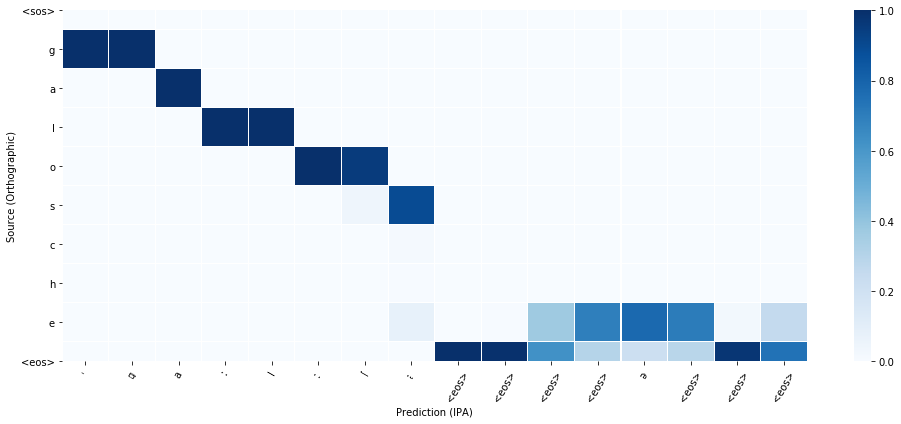

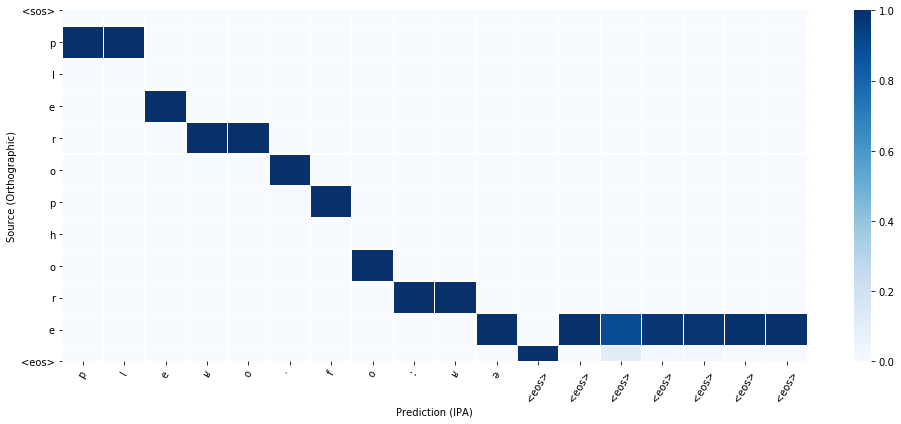

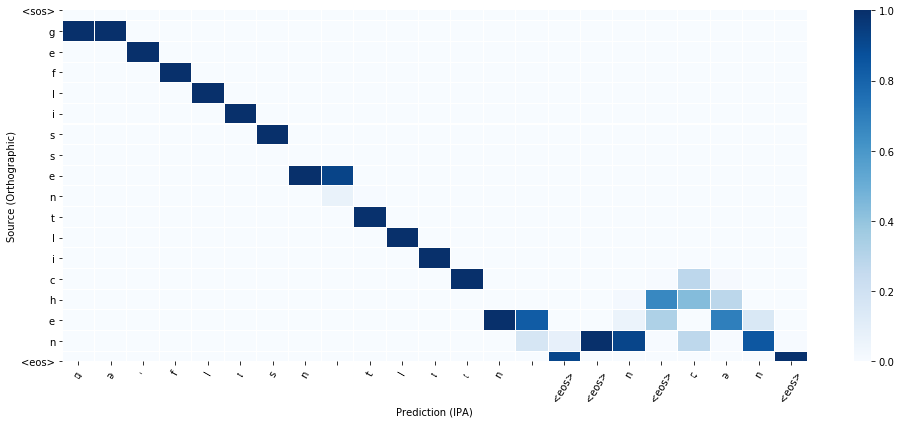

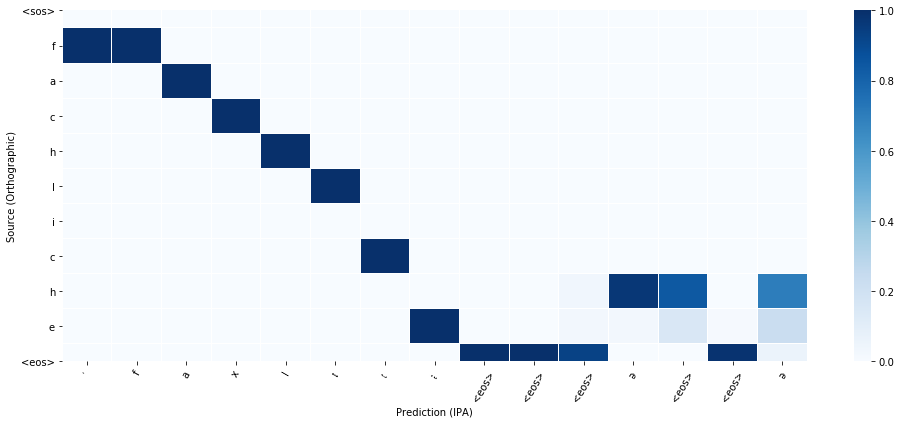

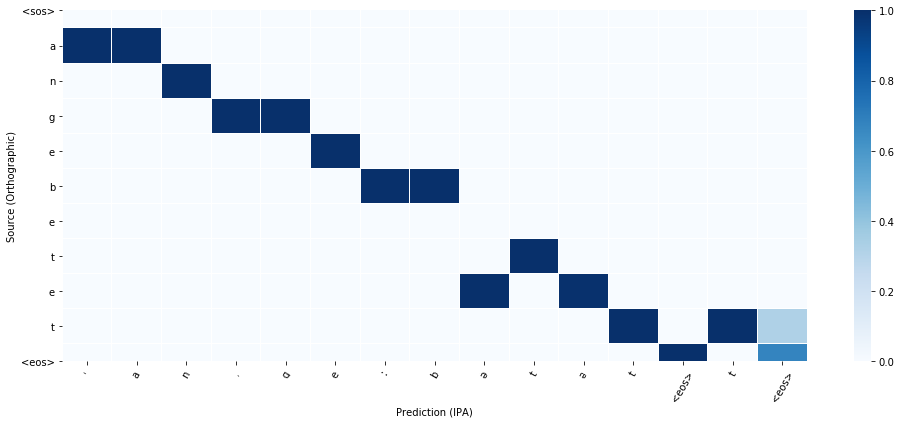

...

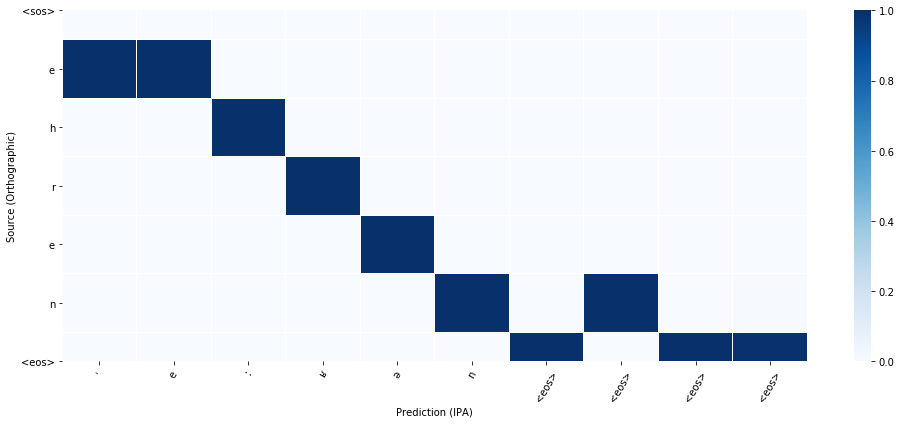

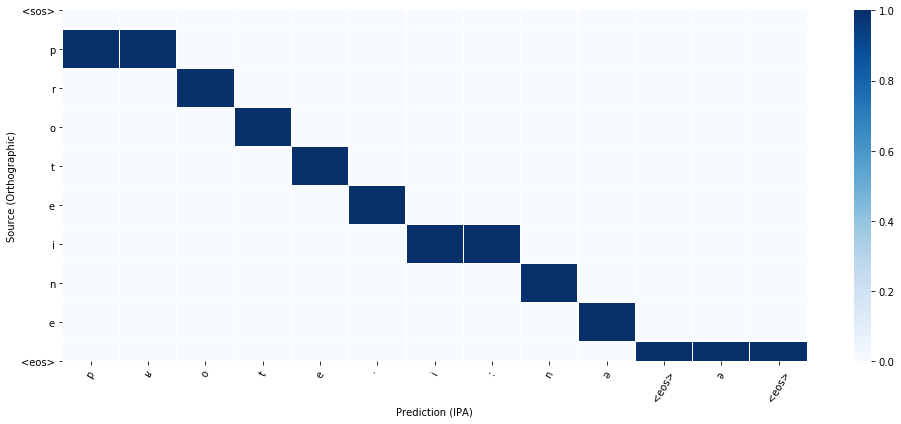

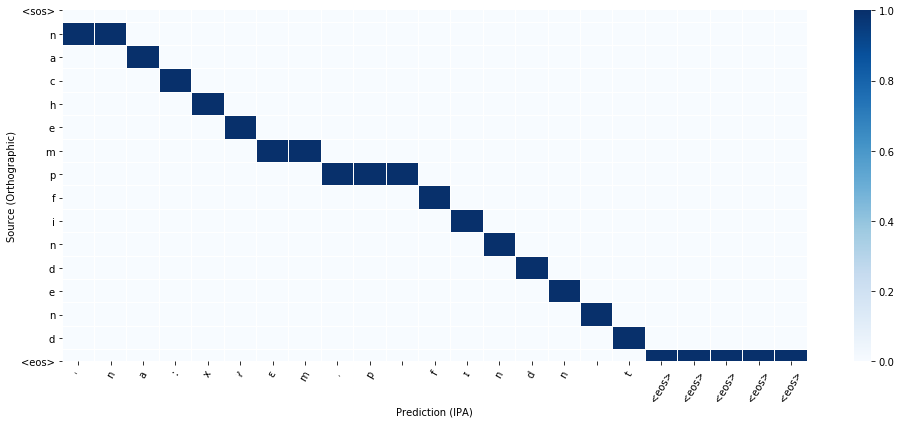

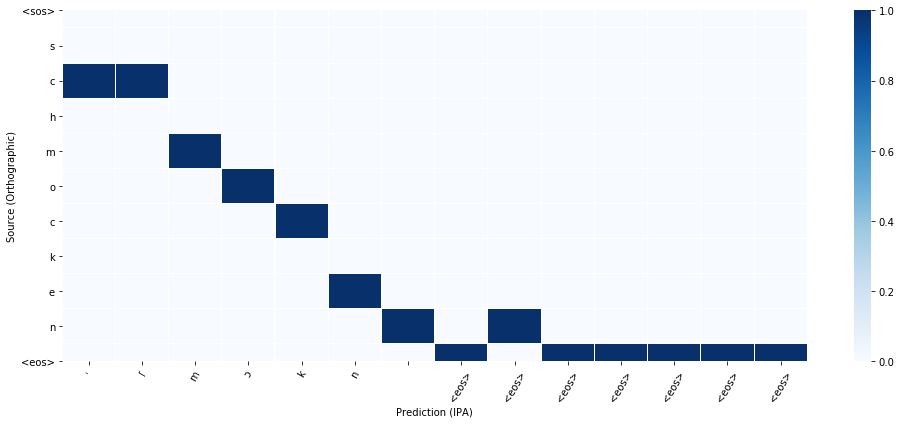

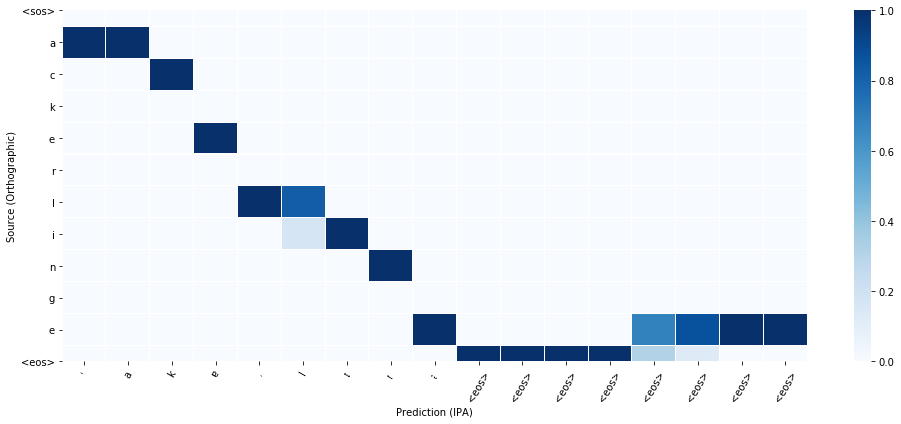

In [3]:
encoder = Encoder(source_vocab_size=len(ortho.vocab),
                  embed_dim=hp.embed_dim, hidden_dim=hp.hidden_dim,
                  n_layers=hp.n_layers, dropout=hp.dropout)
decoder = Decoder(target_vocab_size=len(ipa.vocab),
                  embed_dim=hp.embed_dim, hidden_dim=hp.hidden_dim,
                  n_layers=hp.n_layers, dropout=hp.dropout)
seq2seq = Seq2Seq(encoder, decoder)

seq2seq.to(hp.device)
optimizer = Adam(seq2seq.parameters(), lr=hp.max_lr)
scheduler = SGDRScheduler(optimizer, max_lr=hp.max_lr, cycle_length=hp.cycle_length)

train(seq2seq, optimizer, scheduler, train_iter, val_iter, num_epochs=hp.num_epochs)

In [18]:
from torch import save, load

In [19]:
from german_to_ipa import german_to_ipa

In [20]:
gti = german_to_ipa(ortho,ipa)

In [21]:
gti.load('checkpoints/seq2seq_212630.pt')

AttributeError: 'german_to_ipa' object has no attribute 'load'